>## <b> Evaluation Project 2:HR Analytics Project- Understanding the Attrition in HR  </b>
<b><em> By: Ms. Yashshree bawiskar </em></b>

<b><em> Batch: 1838 </em></b>

## Evaluation Project - 2

### HR Analytics Project- Understanding the Attrition in HR

#### Problem Statement:

Every year a lot of companies hire a number of employees. The companies invest time and money in training those employees, not just this but there are training programs within the companies for their existing employees as well. The aim of these programs is to increase the effectiveness of their employees. But where HR Analytics fit in this? and is it just about improving the performance of employees?

**HR Analytics**

Human resource analytics (HR analytics) is an area in the field of analytics that refers to applying analytic processes to the human resource department of an organization in the hope of improving employee performance and therefore getting a better return on investment. HR analytics does not just deal with gathering data on employee efficiency. Instead, it aims to provide insight into each process by gathering data and then using it to make relevant decisions about how to improve these processes.

**Attrition in HR**

Attrition in human resources refers to the gradual loss of employees overtime. In general, relatively high attrition is problematic for companies. HR professionals often assume a leadership role in designing company compensation programs, work culture, and motivation systems that help the organization retain top employees.

How does Attrition affect companies? and how does HR Analytics help in analyzing attrition? We will discuss the first question here and for the second question, we will write the code and try to understand the process step by step.

**Attrition affecting Companies**

A major problem in high employee attrition is its cost to an organization. Job postings, hiring processes, paperwork, and new hire training are some of the common expenses of losing employees and replacing them. Additionally, regular employee turnover prohibits your organization from increasing its collective knowledge base and experience over time. This is especially concerning if your business is customer-facing, as customers often prefer to interact with familiar people. Errors and issues are more likely if you constantly have new workers.

 

Note: You can find the dataset in the link below.

Downlaod Files:
https://github.com/dsrscientist/IBM_HR_Attrition_Rate_Analytics

## Importing required Liabraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

## Now Loading the dataset

In [2]:
df=pd.read_csv('WA_Fn-UseC_-HR-Employee-Attrition.csv')

In [3]:
#To print all columns and all rows will use  display. max function

pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [4]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2


In [5]:
print('No of Rows:',df.shape[0])
print('No of Columns:',df.shape[1])

No of Rows: 1470
No of Columns: 35


As we able to see in the above dataset 1470 rows and 35 features available.

In [6]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

- ***Above are the column names of my dataset.***

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [8]:
# As we have 35 Columns Lets sort Columns by their datatype
df.columns.to_series().groupby(df.dtypes).groups

{int64: ['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager'], object: ['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime']}

Comment :
-  In this HR dataset we have 1470 rows and 35 columns.
-  Non-null count is same for all Columns, so it seem that it contain No missing value. Still we need to perform Data integrity -  Check for null values in form of "-","NA" , any duplicate entry or error in Data.
-  Out of 35 we have 9 features with Object datatypes and rest are int64 types
-  Among all Numeric Variables 'Education','EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'RelationshipSatisfaction', 'PerformanceRating', 'WorkLifeBalance' are ordinal variable. Unique range of all these ordinal Variable need to check.
- Here We have Target Variable 'Attrition'.

__These Ordinal features come with the following label encoding:__

- Education: 1- 'Below College' , 2 -'College', 3 -'Bachelor', 4- 'Master' ,5 -'Doctor'
- EnvironmentSatisfaction: 1- 'Low', 2- 'Medium', 3 -'High', 4- 'Very High'
- JobInvolvement: 1 -'Low', 2- 'Medium', 3- 'High', 4- 'Very High'
- JobSatisfaction: 1- 'Low', 2- 'Medium', 3- 'High', 4 -'Very High'
- PerformanceRating: 1- 'Low', 2- 'Average', 3 -'Good', 4- 'Excellent', 5- 'Outstanding'
- RelationshipSatisfaction: 1- 'Low', 2- 'Medium', 3- 'High', 4- 'Very High'
- WorkLifeBalance: 1- 'Bad', 2- 'Good', 3- 'Better', 4- 'Best'

In [9]:
df.transpose()

0                       1     \
Age                                    41                      49   
Attrition                             Yes                      No   
BusinessTravel              Travel_Rarely       Travel_Frequently   
DailyRate                            1102                     279   
Department                          Sales  Research & Development   
DistanceFromHome                        1                       8   
Education                               2                       1   
EducationField              Life Sciences           Life Sciences   
EmployeeCount                           1                       1   
EmployeeNumber                          1                       2   
EnvironmentSatisfaction                 2                       3   
Gender                             Female                    Male   
HourlyRate                             94                      61   
JobInvolvement                          3                       2   
JobLevel                                2                       2   
JobRole                   Sales Executive      Research Scientist   
JobSatisfaction                         4                       2   
MaritalStatus                      Single                 Married   
MonthlyIncome                        5993                    5130   
MonthlyRate                         19479                   24907   
NumCompaniesWorked                      8                       1   
Over18                                  Y                       Y   
OverTime                              Yes                      No   
PercentSalaryHike                      11                      23   
PerformanceRating                       3                       4   
RelationshipSatisfaction                1                       4   
StandardHours                          80                      80   
StockOptionLevel                        0                       1   
TotalWorkingYears                       8                      10   
TrainingTimesLastYear                   0                       3   
WorkLifeBalance                         1                       3   
YearsAtCompany                          6                      10   
YearsInCurrentRole                      4                       7   
YearsSinceLastPromotion                 0                       1   
YearsWithCurrManager                    5                       7   

                                            2                       3     \
Age                                           37                      33   
Attrition                                    Yes                      No   
BusinessTravel                     Travel_Rarely       Travel_Frequently   
DailyRate                                   1373                    1392   
Department                Research & Development  Research & Development   
DistanceFromHome                               2                       3   
Education                                      2                       4   
EducationField                             Other           Life Sciences   
EmployeeCount                                  1                       1   
EmployeeNumber                                 4                       5   
EnvironmentSatisfaction                        4                       4   
Gender                                      Male                  Female   
HourlyRate                                    92                      56   
JobInvolvement                                 2                       3   
JobLevel                                       1                       1   
JobRole                    Laboratory Technician      Research Scientist   
JobSatisfaction                                3                       3   
MaritalStatus                             Single                 Married   
MonthlyIncome                               2090                    2909   
MonthlyRate                     

In [10]:
df.duplicated().sum()  # This will check the duplicate data for all columns.

0

In [11]:
df.isnull().sum().any() # Presense of Missing values

False

## Missing value check

In [12]:
missing_values = df.isnull().sum().sort_values(ascending = False)
percentage_missing_values =(missing_values/len(df))*100
print(pd.concat([missing_values, percentage_missing_values], axis =1, keys =['Missing Values', '% Missing data']))

                          Missing Values  % Missing data
Age                                    0             0.0
StandardHours                          0             0.0
NumCompaniesWorked                     0             0.0
Over18                                 0             0.0
OverTime                               0             0.0
PercentSalaryHike                      0             0.0
PerformanceRating                      0             0.0
RelationshipSatisfaction               0             0.0
StockOptionLevel                       0             0.0
MonthlyIncome                          0             0.0
TotalWorkingYears                      0             0.0
TrainingTimesLastYear                  0             0.0
WorkLifeBalance                        0             0.0
YearsAtCompany                         0             0.0
YearsInCurrentRole                     0             0.0
YearsSinceLastPromotion                0             0.0
MonthlyRate                    

In [13]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [14]:
zerovalue=(df==0).astype(bool).sum(axis=0)
print(zerovalue)

Age                           0
Attrition                     0
BusinessTravel                0
DailyRate                     0
Department                    0
DistanceFromHome              0
Education                     0
EducationField                0
EmployeeCount                 0
EmployeeNumber                0
EnvironmentSatisfaction       0
Gender                        0
HourlyRate                    0
JobInvolvement                0
JobLevel                      0
JobRole                       0
JobSatisfaction               0
MaritalStatus                 0
MonthlyIncome                 0
MonthlyRate                   0
NumCompaniesWorked          197
Over18                        0
OverTime                      0
PercentSalaryHike             0
PerformanceRating             0
RelationshipSatisfaction      0
StandardHours                 0
StockOptionLevel            631
TotalWorkingYears            11
TrainingTimesLastYear        54
WorkLifeBalance               0
YearsAtC

<AxesSubplot:>

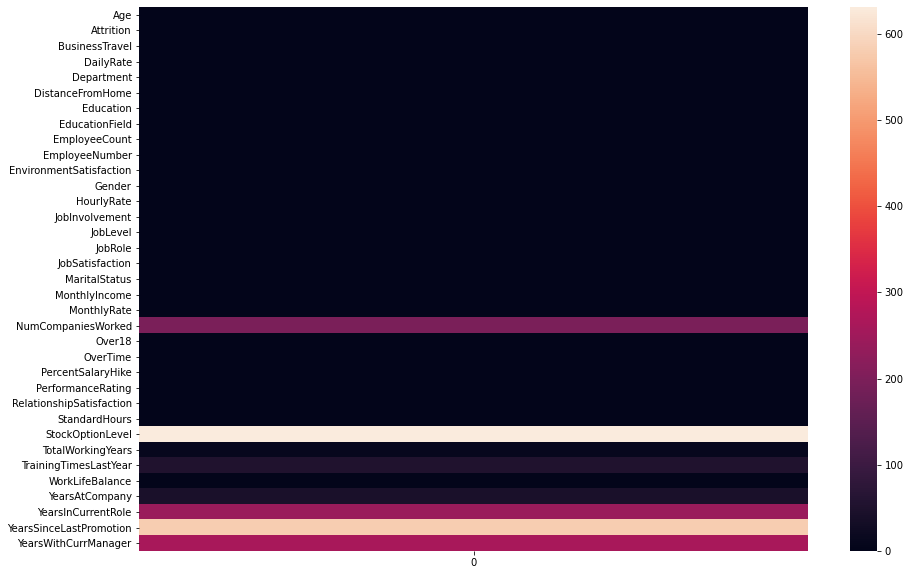

In [15]:
zerovalue1=pd.DataFrame((df==0).astype(bool).sum(axis=0))
plt.figure(figsize=(15,10))
sns.heatmap(zerovalue1)

## Comment:

Luckily for us, there is no missing data! this will make it easier to work with the dataset.

Dataset doesnot contain Any duplicate entry, Missing Values

## Statistical Matrix

<AxesSubplot:>

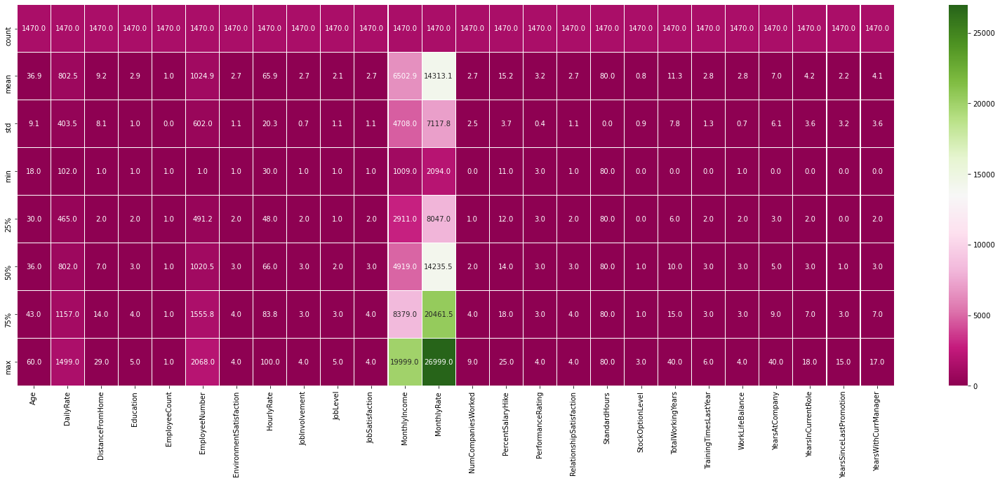

In [16]:
# Visualizing the statistics of the columns using heatmap.
plt.figure(figsize=(28,10))
sns.heatmap(df.describe(),linewidths = 0.1,fmt='0.1f',annot = True,cmap='PiYG')

In [17]:
df.describe(include=['O'])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


In [18]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1470.0,36.923810,9.135373,18.0,30.00,36.0,43.00,60.0
DailyRate,1470.0,802.485714,403.509100,102.0,465.00,802.0,1157.00,1499.0
DistanceFromHome,1470.0,9.192517,8.106864,1.0,2.00,7.0,14.00,29.0
Education,1470.0,2.912925,1.024165,1.0,2.00,3.0,4.00,5.0
EmployeeCount,1470.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
EmployeeNumber,1470.0,1024.865306,602.024335,1.0,491.25,1020.5,1555.75,2068.0
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.0,2.00,3.0,4.00,4.0
HourlyRate,1470.0,65.891156,20.329428,30.0,48.00,66.0,83.75,100.0
JobInvolvement,1470.0,2.729932,0.711561,1.0,2.00,3.0,3.00,4.0
JobLevel,1470.0,2.063946,1.106940,1.0,1.00,2.0,3.00,5.0


<AxesSubplot:>

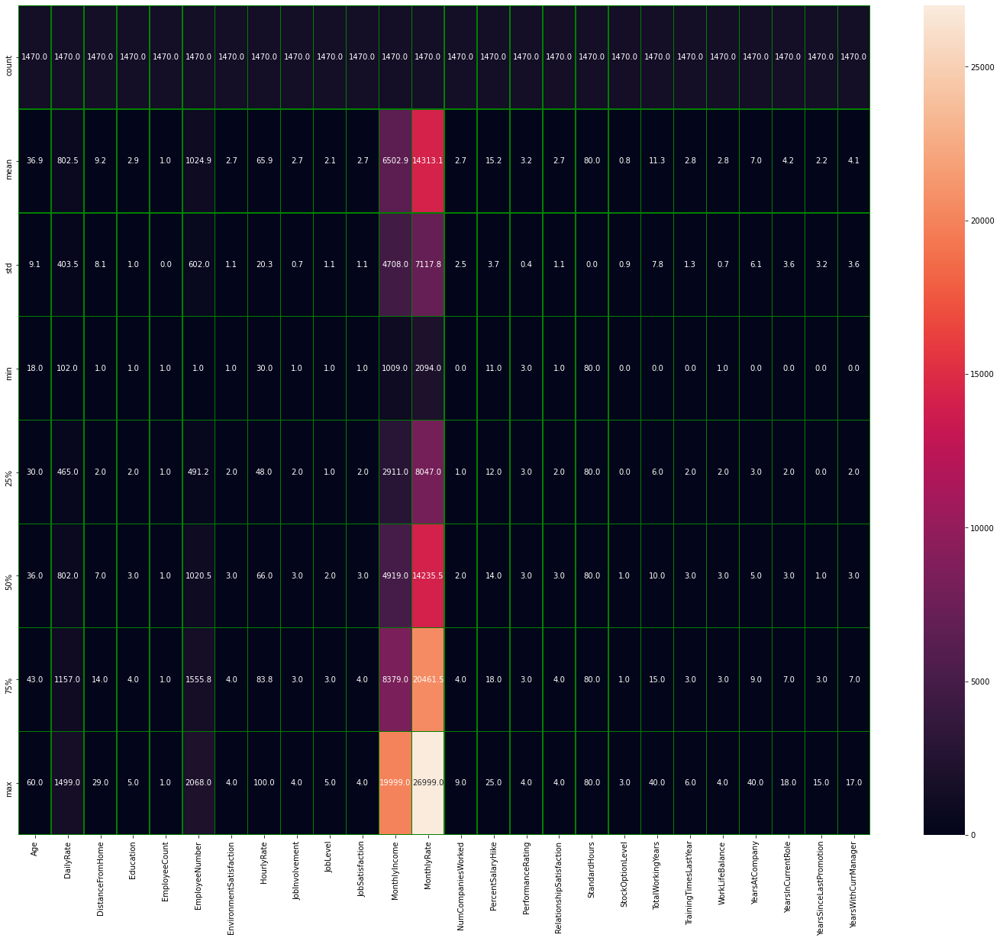

In [19]:
plt.figure(figsize=(25,20))
sns.heatmap(df.describe(),annot=True,linewidth=0.5,linecolor='green',fmt='0.1f')

Heat Map for Description of Dataset

## Comment :

- Minimum Empolyee Age is 18 and Maximum age of employee 60.
- Average distance from home is 9.1 KM. It means that most of employee travel atleast 18 KM in day from home to office.
- On Average performance Rating of employees is 3.163 with min value 3.0. This Means that performance of most of employee is 'Good'.This implies that Attrition of Employee with 'Outstanding' or 5 rating need to investigate.
- 50% of Employees has worked atleast 2 companies previously.
- For Monthly Income,Monthly Rate by looking at 50% and max column we can say outliers exist in this feature.
- By looking at Mean and Median we see that some of the features are skew in nature.
- For ordinal features statstical terminology of mean, median, std deviation doesnot make sense.
- StandardHours and EmployeeCount contain same value for all stastical parameter. It means they contain one unique value.

In [20]:
df['Attrition'].value_counts()

No     1233
Yes     237
Name: Attrition, dtype: int64

<Figure size 432x288 with 0 Axes>

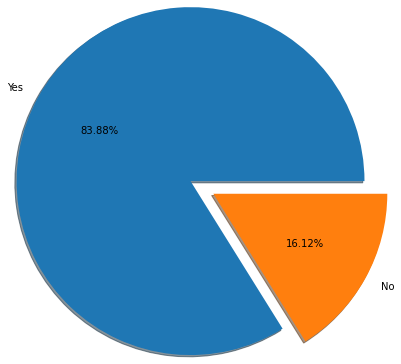

In [21]:
labels = 'Yes','No'
plt.figure(facecolor='white')
fig, ax = plt.subplots()
ax.pie(df['Attrition'].value_counts(),labels = labels,radius =2,autopct = '%2.2f%%',explode=[0.1,0.2], shadow=True,)
plt.show()

## Observation:

**83.88% (1237 employees) Employees did not leave the organization while 16.12% (237 employees) did leave the organization making our dataset to be considered imbalanced since more people stay in the organization than they actually leave.**

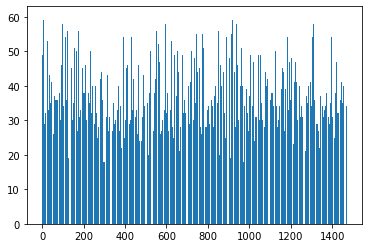

In [22]:
plt.bar(df.index,df['Age'])
plt.show()

<AxesSubplot:>

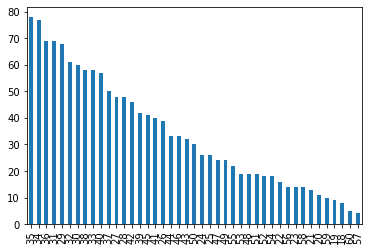

In [23]:
df['Age'].value_counts().plot.bar()

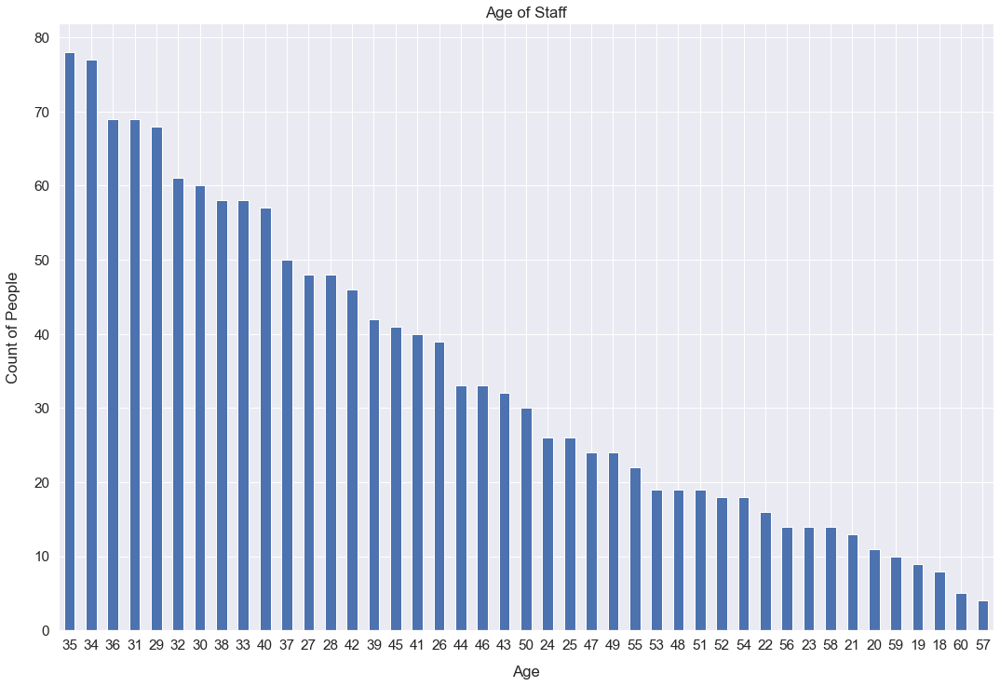

In [24]:
sns.set(font_scale=1.4)
df['Age'].value_counts().plot(kind='bar', figsize=(18,12), rot=0)
plt.xlabel("Age", labelpad=14)
plt.ylabel("Count of People", labelpad=14)
plt.title("Age of Staff", y=1);

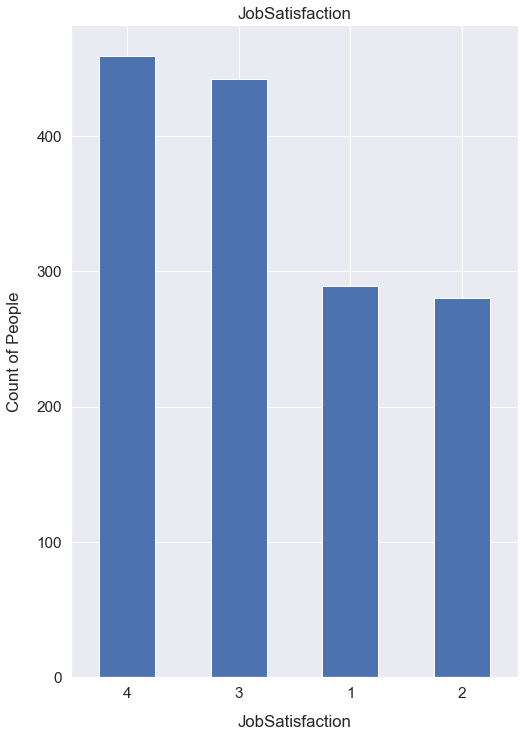

In [25]:
sns.set(font_scale=1.4)
df['JobSatisfaction'].value_counts().plot(kind='bar', figsize=(8,12), rot=0)
plt.xlabel("JobSatisfaction", labelpad=14)
plt.ylabel("Count of People", labelpad=14)
plt.title("JobSatisfaction", y=1);

<AxesSubplot:xlabel='BusinessTravel', ylabel='count'>

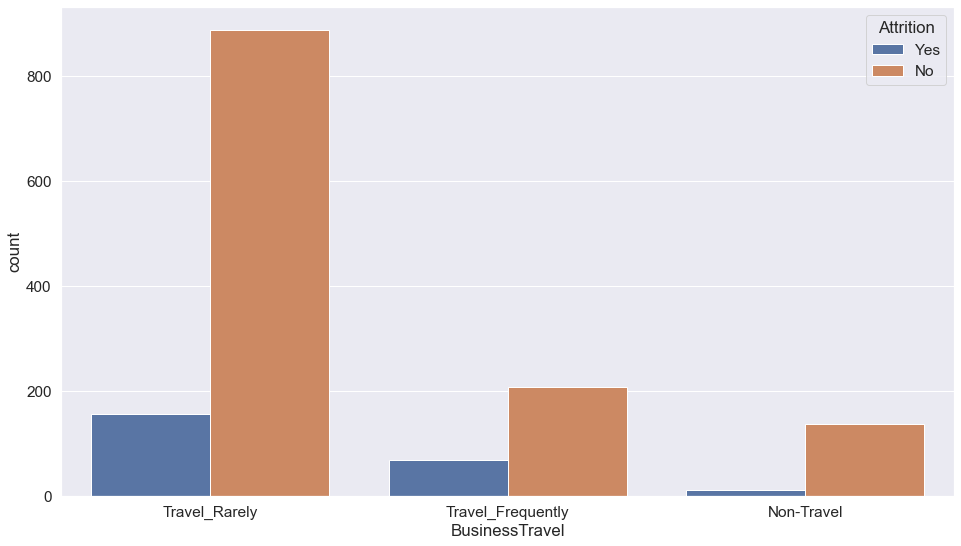

In [26]:
plt.figure(figsize = (16,9))
sns.countplot('BusinessTravel', hue='Attrition', data=df)

In [27]:
Category=['Attrition', 'BusinessTravel', 'Department', 'EducationField',
          'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime' ]
for i in Category:
    print(i)
    print(df[i].value_counts())
    print("="*100)

Attrition
No     1233
Yes     237
Name: Attrition, dtype: int64
BusinessTravel
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: BusinessTravel, dtype: int64
Department
Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64
EducationField
Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64
Gender
Male      882
Female    588
Name: Gender, dtype: int64
JobRole
Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: JobRole, dtype: int64
MaritalStatus
Married     673
Single      470
Divorced    327
Name: MaritalStatus, dtyp

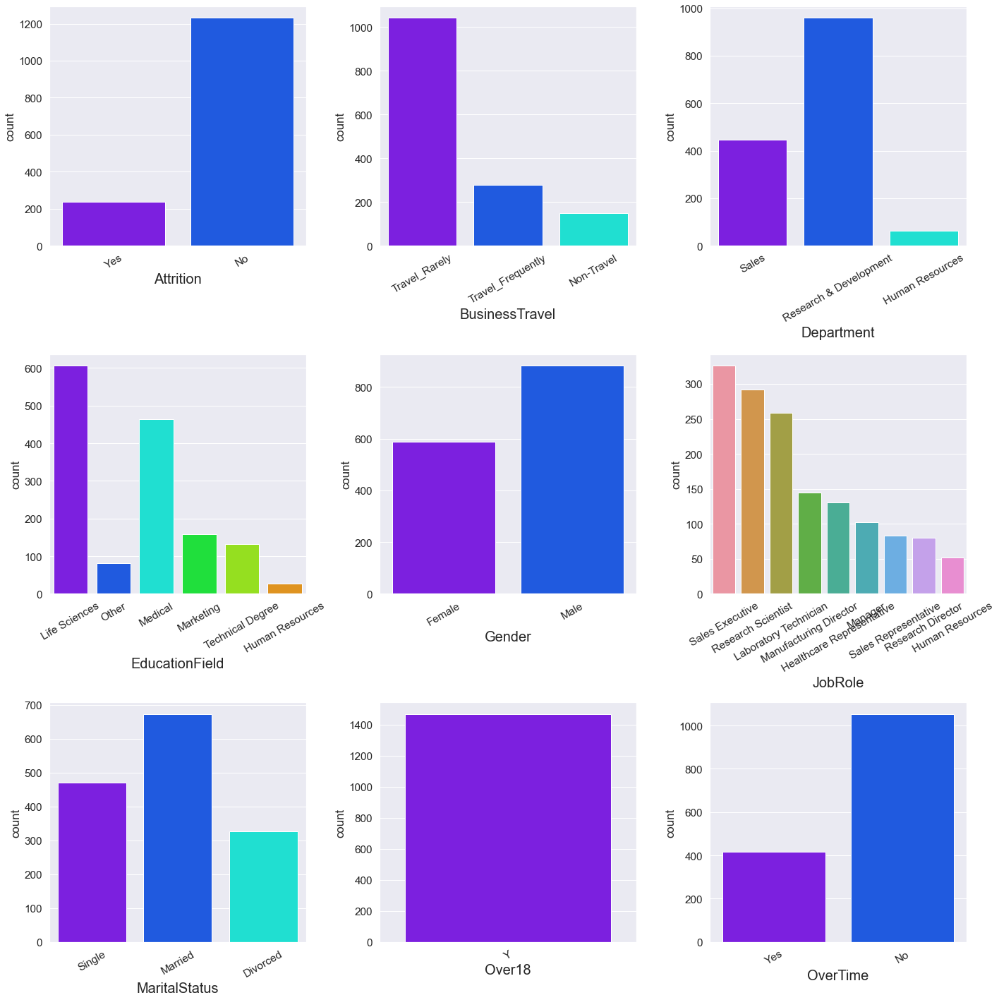

In [28]:
sns.set_palette('gist_rainbow_r')
plt.figure(figsize=(20,20), facecolor='white')
plotnumber =1
Category=['Attrition', 'BusinessTravel', 'Department', 'EducationField',
          'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime' ]
for i in Category:
    if plotnumber <=9:
        ax = plt.subplot(3,3,plotnumber)
        sns.countplot(df[i])
        plt.xlabel(i,fontsize=20)
        plt.xticks(rotation=30)
    plotnumber+=1
plt.tight_layout()
plt.show()

In [29]:
Ordinal=['Education','EnvironmentSatisfaction', 'JobInvolvement','JobSatisfaction',
          'RelationshipSatisfaction', 'PerformanceRating', 'WorkLifeBalance' ]
for i in Ordinal:
    print(i)
    print(df[i].value_counts())
    print("="*100)

Education
3    572
4    398
2    282
1    170
5     48
Name: Education, dtype: int64
EnvironmentSatisfaction
3    453
4    446
2    287
1    284
Name: EnvironmentSatisfaction, dtype: int64
JobInvolvement
3    868
2    375
4    144
1     83
Name: JobInvolvement, dtype: int64
JobSatisfaction
4    459
3    442
1    289
2    280
Name: JobSatisfaction, dtype: int64
RelationshipSatisfaction
3    459
4    432
2    303
1    276
Name: RelationshipSatisfaction, dtype: int64
PerformanceRating
3    1244
4     226
Name: PerformanceRating, dtype: int64
WorkLifeBalance
3    893
2    344
4    153
1     80
Name: WorkLifeBalance, dtype: int64


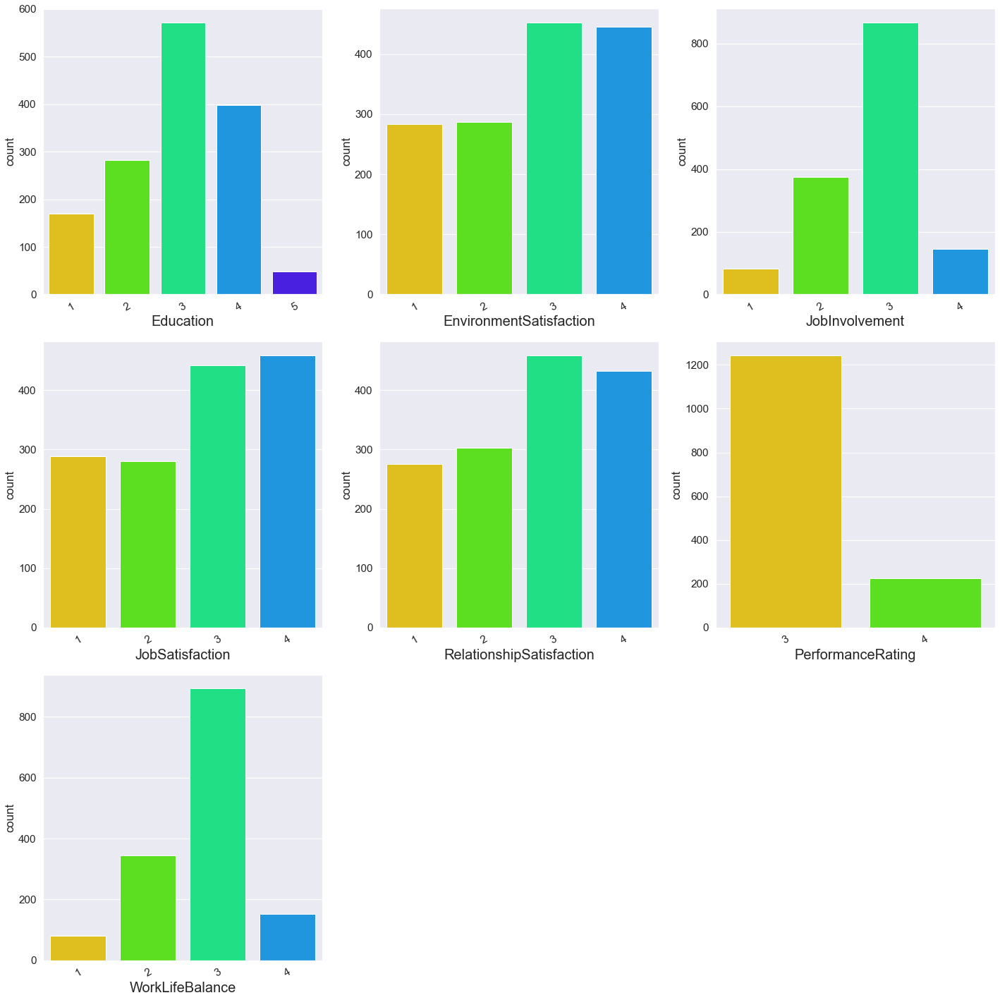

In [30]:
sns.set_palette('hsv')
plt.figure(figsize=(20,20), facecolor='white')
plotnumber =1
Ordinal=['Education','EnvironmentSatisfaction', 'JobInvolvement','JobSatisfaction',
          'RelationshipSatisfaction', 'PerformanceRating', 'WorkLifeBalance' ]
for i in Ordinal:
    if plotnumber <=9:
        ax = plt.subplot(3,3,plotnumber)
        sns.countplot(df[i])
        plt.xlabel(i,fontsize=20)
        plt.xticks(rotation=30)
    plotnumber+=1
plt.tight_layout()
plt.show()

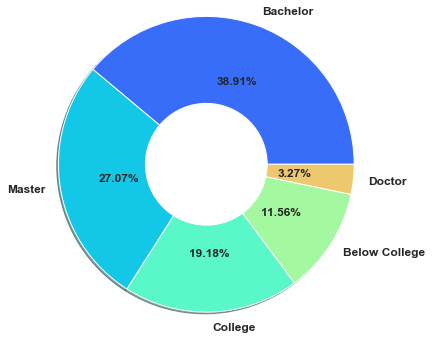

In [31]:
sns.set_palette('rainbow')
labels='Bachelor','Master','College','Below College','Doctor'
fig, ax = plt.subplots()
ax.pie(df['Education'].value_counts(),labels = labels,radius =1.7,
       autopct = '%3.2f%%',textprops ={ 'fontweight': 'bold','fontsize':12}, shadow=True)
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.show()

## Comment:
    
- More than 60 % employees educated at Masters & Bachelor. It interesting to find out in which department need this human resources.
- 30 % of Employees are highly educated which involves master and doctor degree.
- 39 % of Employees are graduate.
- Almost 19% Employees are educated upto college & 12% are below college.
- Lets try to gain insight on to which department this Human Resource belong and education need of each department through visualization.

In [32]:
df['Department'].value_counts()

Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64

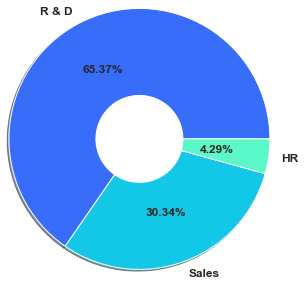

In [33]:
labels ='R & D','Sales','HR'
fig,ax= plt.subplots()
sns.set_palette('husl')
ax.pie(df['Department'].value_counts(),labels=labels, radius=1.5,
       textprops ={ 'fontweight': 'bold','fontsize':12},autopct= '%3.2f%%',shadow=True)

centre_circle = plt.Circle((0, 0), 0.50, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.show()

In [34]:
print('Education Level of Employees working in different Department')
pd.crosstab([df.Education],[df.Department], margins=True).style.background_gradient(cmap='gist_earth_r')

Education Level of Employees working in different Department


Department,Human Resources,Research & Development,Sales,All
Education,,,,
1,5,115,50,170
2,13,182,87,282
3,27,379,166,572
4,15,255,128,398
5,3,30,15,48
All,63,961,446,1470


**Comment :**
    
65.37% of Employees belong to Research & Development Department. Out of Total 961 Employee no of employee educated at Bachelors,Masters, Doctor are 379,255 and 30 respectively.
Only 63 Employee work in HR department.

In [35]:
pd.crosstab([df.Education],[df.Department,df.Attrition], margins=True).style.background_gradient(cmap='gist_earth_r')

In [36]:
df['EducationField'].value_counts()

Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64

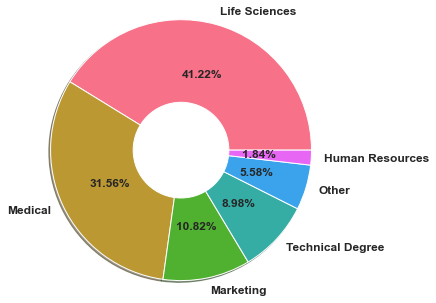

In [37]:
labels ='Life Sciences','Medical','Marketing','Technical Degree','Other','Human Resources'
fig,ax= plt.subplots()
ax.pie(df['EducationField'].value_counts(),labels=labels, radius=1.5,
       textprops ={ 'fontweight': 'bold','fontsize':12}, autopct= '%2.2f%%',shadow=True)

centre_circle = plt.Circle((0, 0), 0.550, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.show()

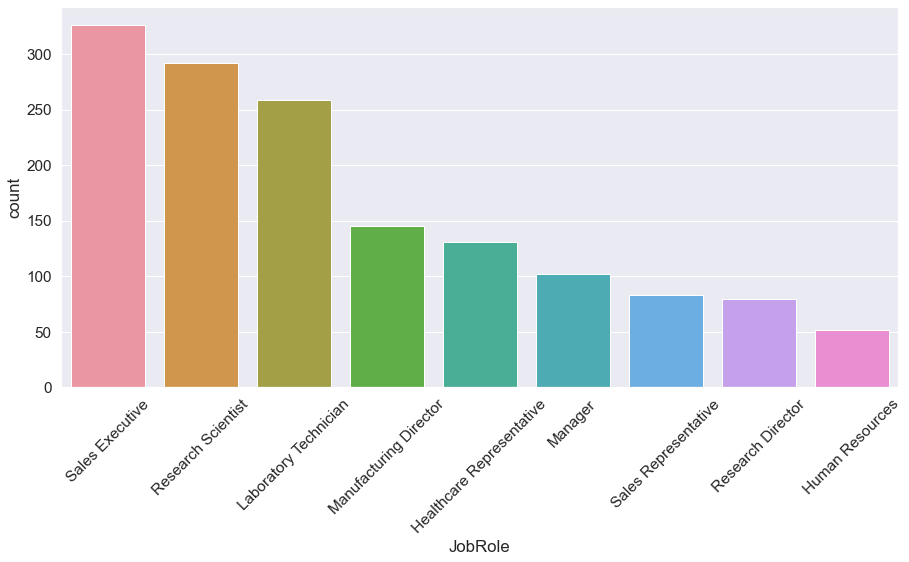

In [38]:
plt.figure(figsize=(15,7))
sns.countplot(df['JobRole'])
plt.xticks(rotation=45)
plt.show()

In [39]:
pd.crosstab([df.JobRole],[df.Department], margins=True).style.background_gradient(cmap='Set3')

Department,Human Resources,Research & Development,Sales,All
JobRole,,,,
Healthcare Representative,0,131,0,131
Human Resources,52,0,0,52
Laboratory Technician,0,259,0,259
Manager,11,54,37,102
Manufacturing Director,0,145,0,145
Research Director,0,80,0,80
Research Scientist,0,292,0,292
Sales Executive,0,0,326,326
Sales Representative,0,0,83,83


**Comment:**
- There are 3 job role in HR Department, maximum of which are sales Executive with 446 Total Employees.
- Human Resources department has 2 Job role i.e. HR & Manager.
- There 6 different Job role in R&D department with total 961 employees and until now we know that all of them belong to thier respective domain background

<Figure size 864x720 with 0 Axes>

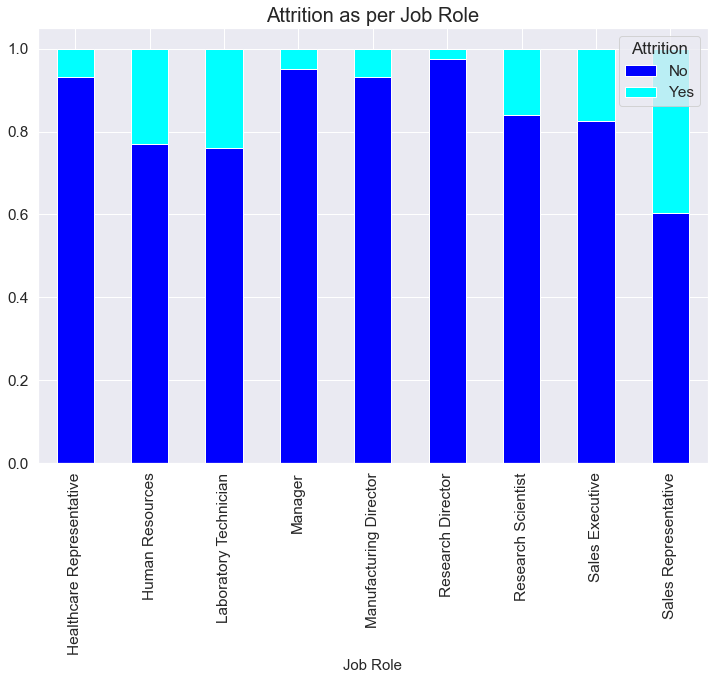

In [40]:
plt.figure(figsize=(12,10))
data=pd.crosstab(df['JobRole'], df['Attrition'])
data.div(data.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True, 
                    color=['blue', 'cyan'],figsize=(12,8))
plt.title('Attrition as per Job Role', fontsize=20)
plt.xlabel('Job Role',fontsize=15)
plt.show()

We all can definitely see Red Signal for different Managers & HR of Respective Job Role in above barplot !!!

Bar plot showing % attrition across each job role, let check absolute number matrix of attrition, again this time using crosstab.

In [41]:
pd.crosstab([df.JobRole,df.Department],[df.Attrition], margins=True).style.background_gradient(cmap='Blues_r')

obervations:
-  Percentage of attrition is high in Sales Representative,Laboratory Technician,Human Resources. 
-  This all job role comes at bottom in corparate hierachy also Salary is comparatively less compare to other job role.
-  Monthly Income, Job stastifation, travelling are feature need to dive into for further insights in these job role.
-  At the Top chart 62 Laboratory Technician has resign from job, followed by 57 sales executive and 47 Research Scientist.
-  16 % arttrition rate for Research Scientist, which involve huge investment from company. Company not only loses employee but -  its knowledge base, expertise & Intellatual property rights in some cases.

In [42]:
# Grouping Numeric Features
Num_features=['Age', 'DailyRate', 'DistanceFromHome',  
 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 
 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 
 'RelationshipSatisfaction','StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

In [43]:
# Grouping Numeric variable
Numeric_Veriable=['Age', 'DailyRate', 'DistanceFromHome', 'HourlyRate','MonthlyIncome', 'MonthlyRate', 
             'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears','TrainingTimesLastYear',
             'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

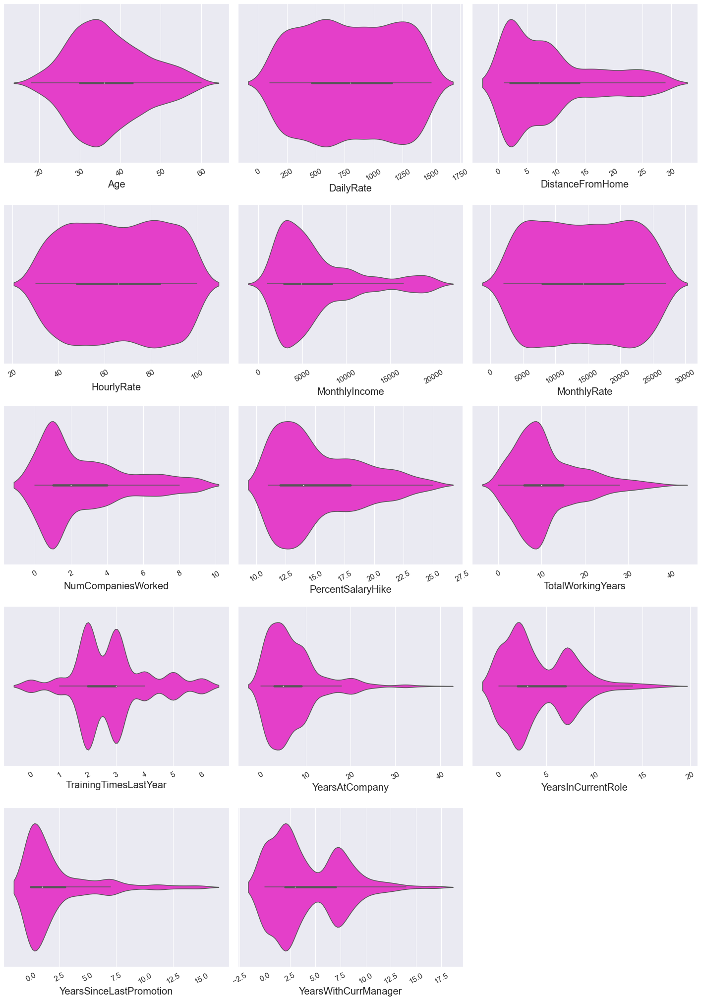

In [44]:
sns.set_palette('spring')
plt.figure(figsize=(20,50), facecolor='white')
plotnumber =1

for i in Numeric_Veriable:
    if plotnumber <=25:
        ax = plt.subplot(9,3,plotnumber)
        sns.violinplot(df[i])
        plt.xlabel(i,fontsize=20)
        plt.xticks(rotation=30)
    plotnumber+=1
plt.tight_layout()
plt.show()

Majority of people are trained 2-3 times in last year.If employees leaves job then it loss investment for company.

<AxesSubplot:xlabel='Age', ylabel='count'>

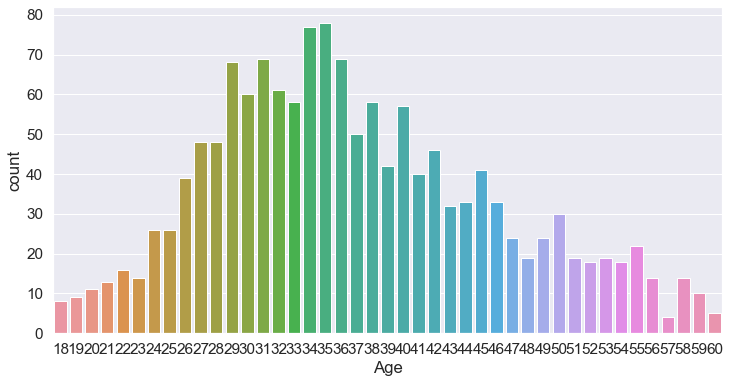

In [45]:
plt.subplots(figsize=(12,6))
sns.countplot(df['Age'])

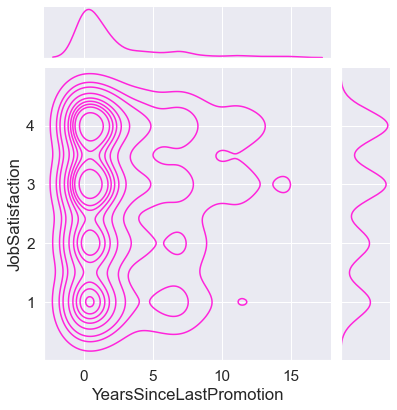

In [46]:
sns.jointplot(x=df['YearsSinceLastPromotion'], y=df['JobSatisfaction'], kind='kde')

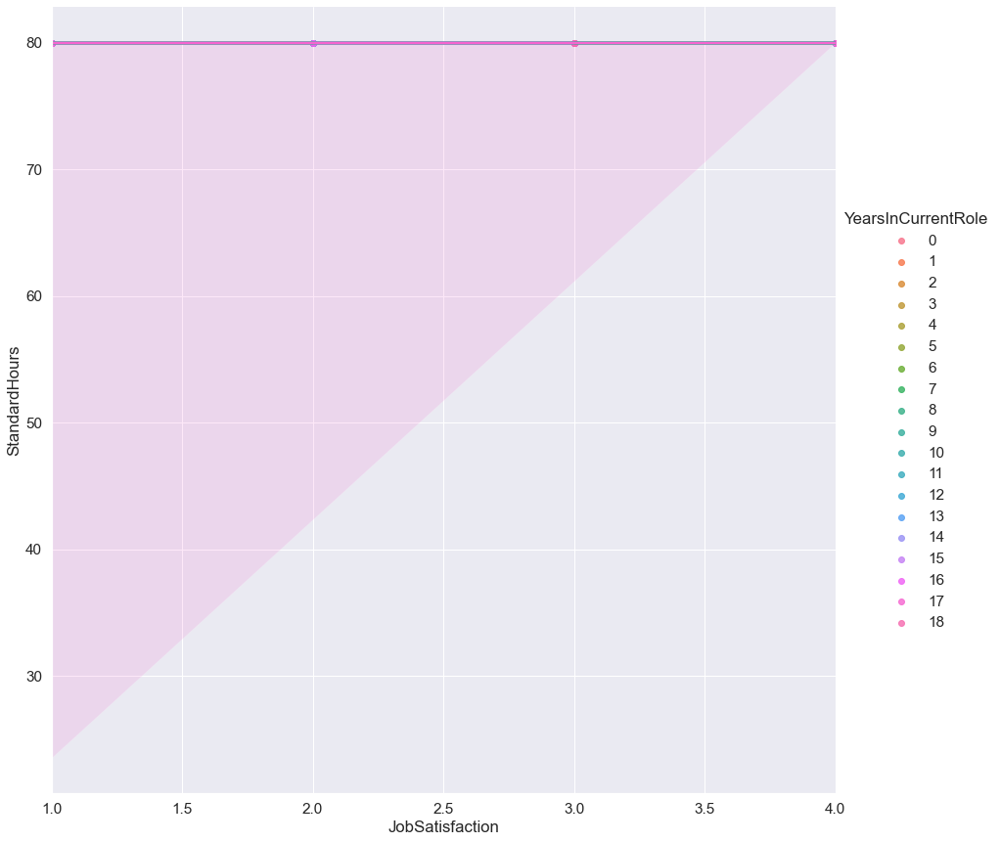

In [47]:
sns.lmplot(data=df, x='JobSatisfaction', y='StandardHours', size=12, hue='YearsInCurrentRole')

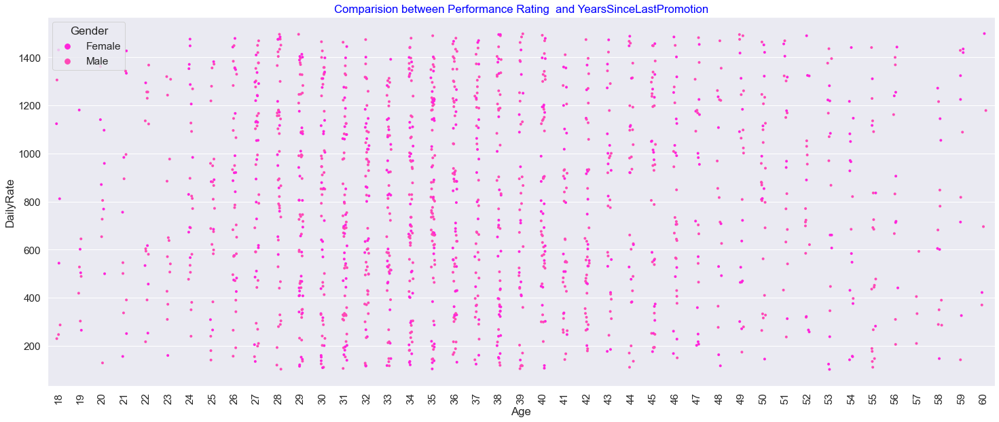

In [48]:
plt.figure(figsize=(25,10))
plt.xticks(rotation = 90)
plt.title('Comparision between Performance Rating  and YearsSinceLastPromotion',color='blue')
sns.stripplot(x='Age',y='DailyRate',data=df,size=4,hue='Gender')
plt.show()

<AxesSubplot:xlabel='Age', ylabel='count'>

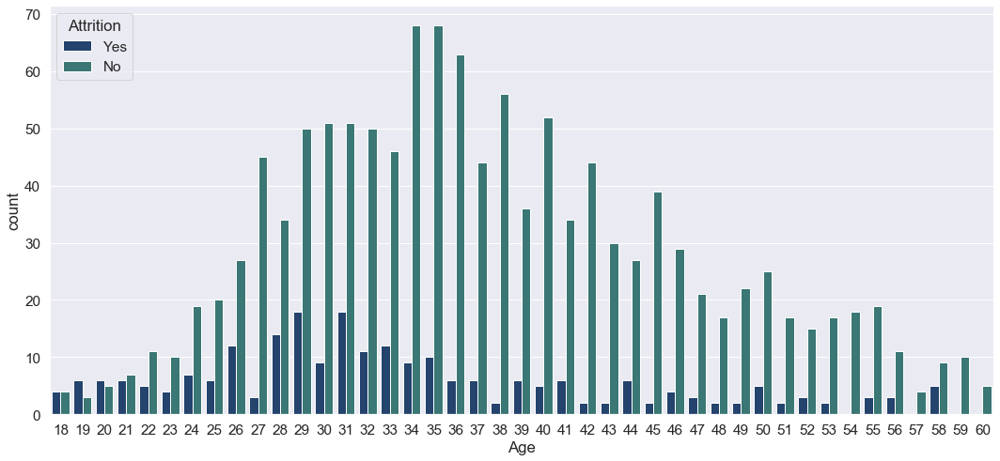

In [49]:
sns.set_palette('gist_earth')
plt.subplots(figsize=(18,8))
sns.countplot(x='Age', hue='Attrition', data=df)

Observation:
    
The Attrition rate is minimum between the Age years of 34 and 35.

The Attrition rate is maximum between the Age years of 29 and 31.

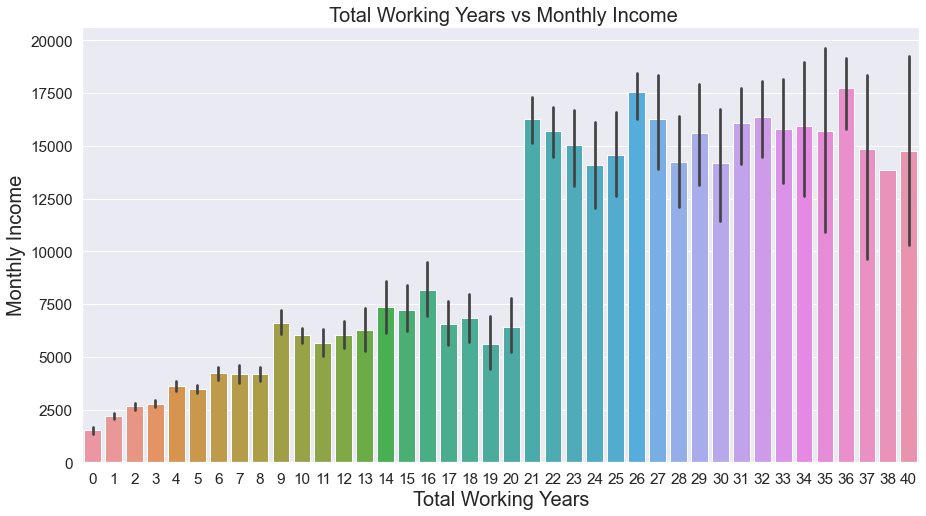

In [50]:
plt.figure(figsize=(15,8))
sns.barplot(df['TotalWorkingYears'],df['MonthlyIncome'])
plt.xlabel('Total Working Years',fontsize=20)
plt.ylabel('Monthly Income',fontsize=20)
plt.title(" Total Working Years vs Monthly Income", fontsize=20)
plt.show()

Monthly Income is highest for the employees with 21 or more number of Total Working Years.

Minimum age on dataset is 18 and the maximum age is 60


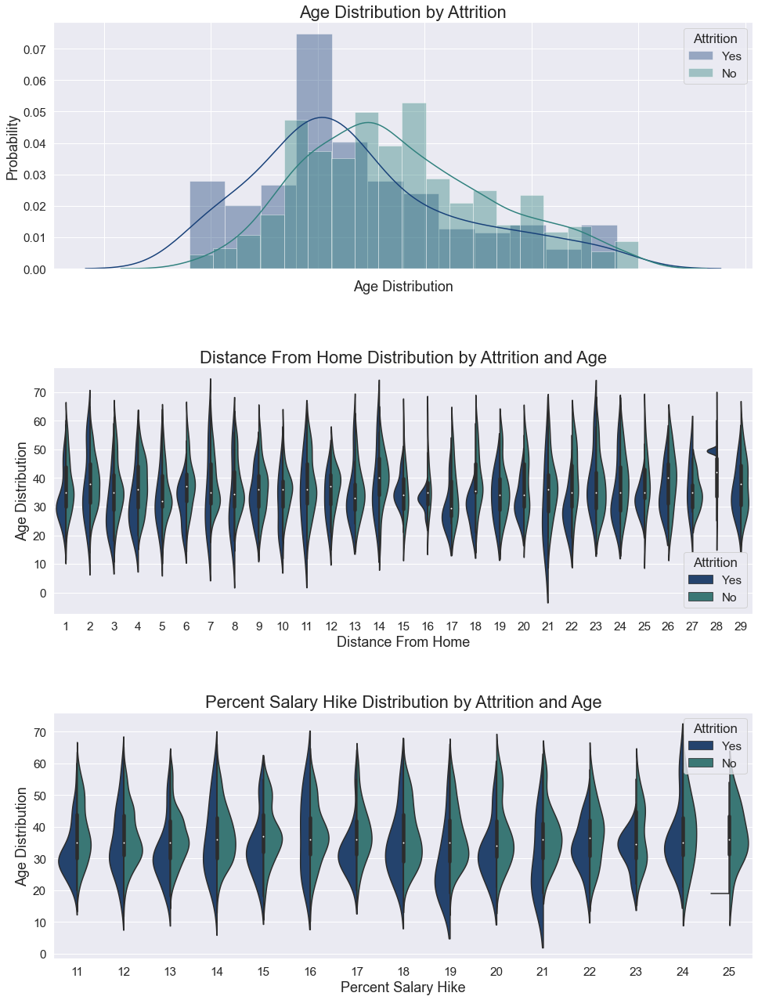

In [51]:
# PercentSalaryHike, DistanceFromHome, Age
print(f'Minimum age on dataset is {df["Age"].min()} and the maximum age is {df["Age"].max()}')
plt.figure(figsize=(16,22))

plt.subplot(3,1,1)
g = sns.distplot(df[df['Attrition'] == 'Yes']['Age'], label='Yes')
g = sns.distplot(df[df['Attrition'] == 'No']['Age'], label="No")
g.set_xticklabels(g.get_xticklabels(),rotation=0)
g.legend(title='Attrition')
g.set_title("Age Distribution by Attrition", fontsize=22)
g.set_xlabel("Age Distribution", fontsize=18)
g.set_ylabel("Probability", fontsize=18)

plt.subplot(3,1,2)
g1 = sns.violinplot(x='DistanceFromHome', y='Age', hue='Attrition', 
                    split=True, data=df, size=3)
g1.set_xticklabels(g1.get_xticklabels(),rotation=0)
g1.set_title("Distance From Home Distribution by Attrition and Age", fontsize=22)
g1.set_xlabel("Distance From Home", fontsize=18)
g1.set_ylabel("Age Distribution", fontsize=18)

plt.subplot(3,1,3)
g2 = sns.violinplot(x='PercentSalaryHike', y='Age',
                    split=True, hue='Attrition',data=df)
g2.set_xticklabels(g2.get_xticklabels(),rotation=0)
g2.set_title("Percent Salary Hike Distribution by Attrition and Age", fontsize=22)
g2.set_xlabel("Percent Salary Hike", fontsize=18)
g2.set_ylabel("Age Distribution", fontsize=18)

plt.subplots_adjust(hspace = 0.4)

plt.show()

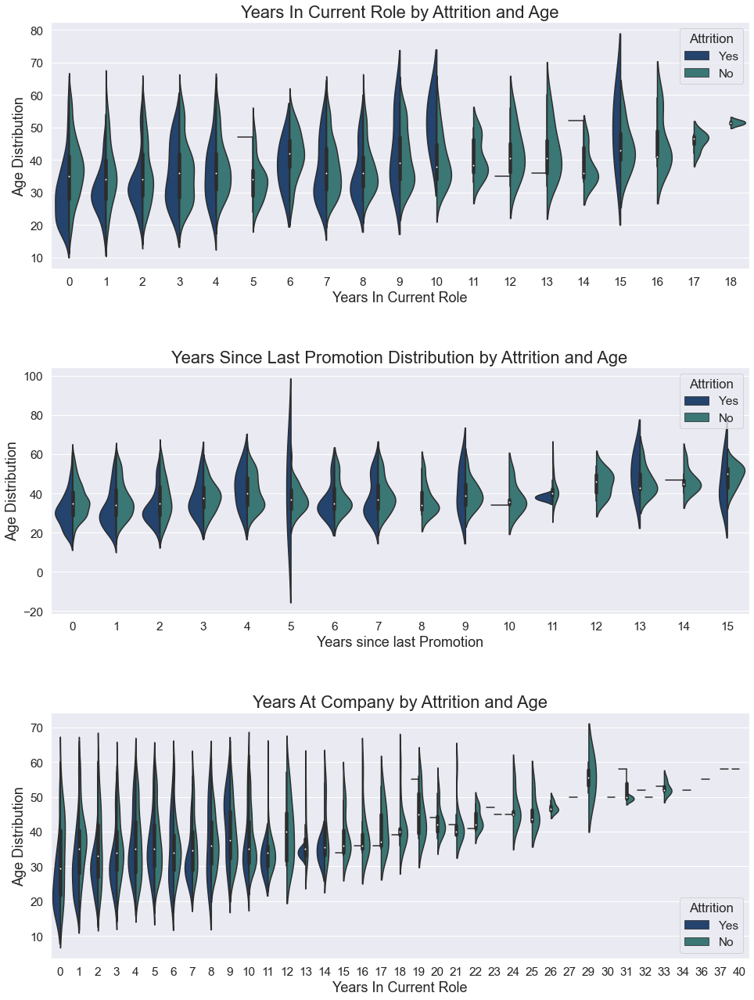

In [52]:
plt.figure(figsize=(16,22))

plt.subplot(3,1,1)
g = sns.violinplot(x='YearsInCurrentRole', y= 'Age', 
                   split=True, hue='Attrition', data=df)
g.set_xticklabels(g.get_xticklabels(),rotation=0)
g.set_title("Years In Current Role by Attrition and Age", fontsize=22)
g.set_xlabel("Years In Current Role", fontsize=18)
g.set_ylabel("Age Distribution", fontsize=18)

plt.subplot(3,1,2)
g1 = sns.violinplot(x='YearsSinceLastPromotion', y= 'Age', 
                    split=True, hue='Attrition', data=df)
g1.set_xticklabels(g1.get_xticklabels(),rotation=0)
g1.set_title("Years Since Last Promotion Distribution by Attrition and Age", fontsize=22)
g1.set_xlabel("Years since last Promotion", fontsize=18)
g1.set_ylabel("Age Distribution", fontsize=18)

plt.subplot(3,1,3)
g2 = sns.violinplot(x='YearsAtCompany', y= 'Age', 
                   split=True, hue='Attrition', data=df)
g2.set_xticklabels(g2.get_xticklabels(),rotation=0)
g2.set_title("Years At Company by Attrition and Age", fontsize=22)
g2.set_xlabel("Years In Current Role", fontsize=18)
g2.set_ylabel("Age Distribution", fontsize=18)

plt.subplots_adjust(hspace = 0.4)

plt.show()

On Years at Company we can see that people with more than 12 years are less propense to leave the company.
The same pattern we can see on Years in current Role... After 15 years in the current role, we don't have siginificant number of Attrition;`

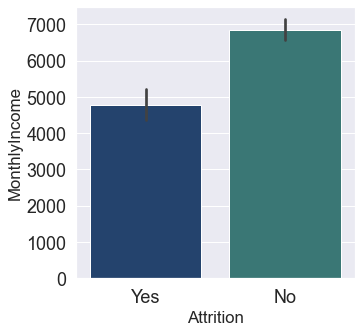

In [53]:
plt.figure(figsize=(5,5))
sns.barplot(x='Attrition',y='MonthlyIncome',data=df)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.show()

As monthly inocme go in upward direction i.e increasing , the less employee attribution is having.

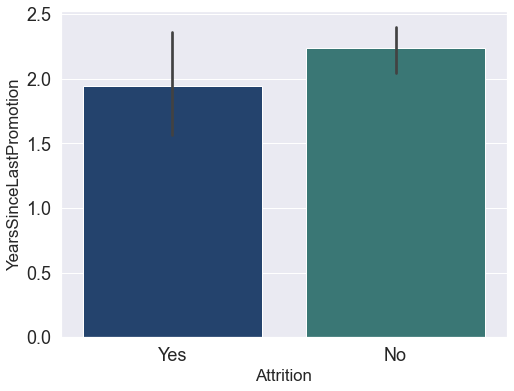

In [54]:
plt.figure(figsize=(8,6))
sns.barplot(x='Attrition',y='YearsSinceLastPromotion',data=df)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.show()

Employee attrition is high when they have not promoted more than 1.5 years

In [55]:
print("Monthly Income Quantiles Distribution: ")
print(df['MonthlyIncome'].quantile([.01, .25, .5, .75, .99]))

Monthly Income Quantiles Distribution: 
0.01     1382.46
0.25     2911.00
0.50     4919.00
0.75     8379.00
0.99    19626.31
Name: MonthlyIncome, dtype: float64


In [56]:
def get_ratio(df, cat_col):
    attr_temp = df.groupby([cat_col, 'Attrition'])['EmployeeNumber'].count().unstack('Attrition').reset_index()
    attr_temp['ratio'] = round(attr_temp['Yes'] / (attr_temp['Yes'] + attr_temp['No']) * 100,2)
    attr_temp = attr_temp[[cat_col, 'ratio']]
    
    return attr_temp

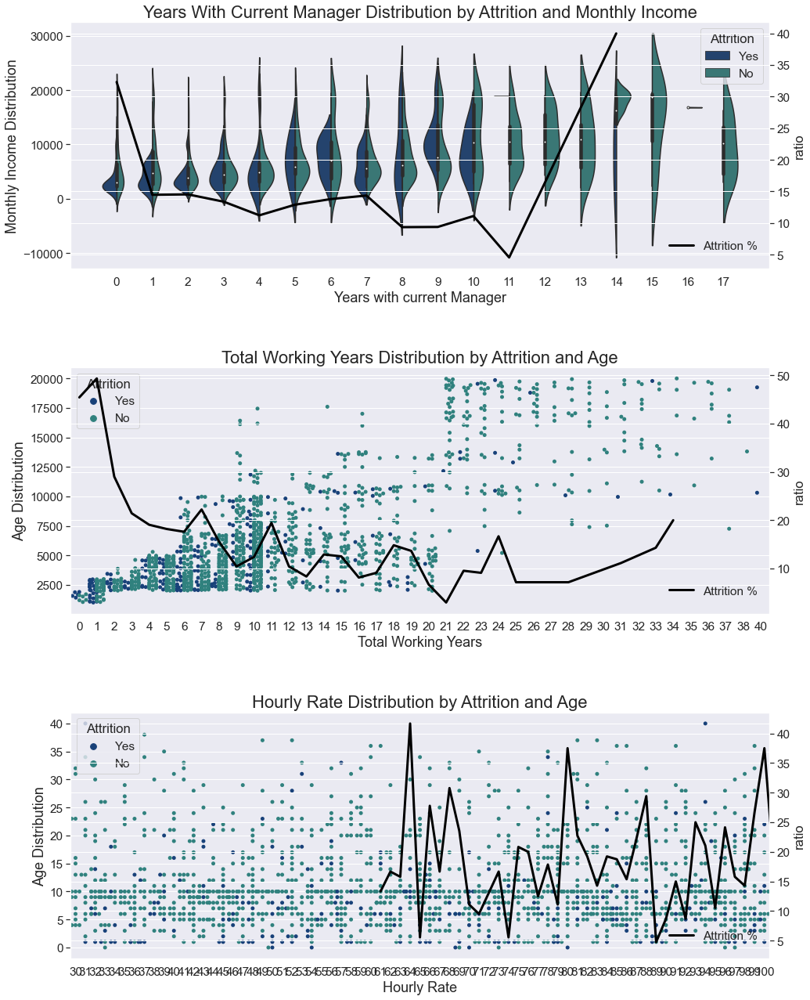

In [57]:
plt.figure(figsize=(16,22))

plt.subplot(3,1,1)

g = sns.violinplot(x='YearsWithCurrManager', y= 'MonthlyIncome', hue='Attrition',data=df, split=True)
g.set_xticklabels(g.get_xticklabels(),rotation=0)
g.set_title("Years With Current Manager Distribution by Attrition and Monthly Income", fontsize=22)
g.set_xlabel("Years with current Manager", fontsize=18)
g.set_ylabel("Monthly Income Distribution", fontsize=18)
ax2 = g.twinx()
attr_temp = get_ratio(df, 'YearsWithCurrManager')
gg = sns.lineplot(x='YearsWithCurrManager', y= 'ratio', ax=ax2, lw=3, markers='o',label="Attrition %", color='black',data=attr_temp)
gg.legend( loc = (.85, .05), frameon = False)


plt.subplot(3,1,2)
g1 = sns.swarmplot(x='TotalWorkingYears', y= 'MonthlyIncome', dodge=True, hue='Attrition', data=df)
ax3 = g1.twinx()
attr_temp = get_ratio(df, 'TotalWorkingYears')
gg = sns.lineplot(x='TotalWorkingYears', y= 'ratio', ax=ax3, lw=3, markers='o',label="Attrition %", color='black',data=attr_temp)
gg.legend( loc = (.85, .05), frameon = False)
g1.set_xticklabels(g1.get_xticklabels(),rotation=0)
g1.set_title("Total Working Years Distribution by Attrition and Age", fontsize=22)
g1.set_xlabel("Total Working Years", fontsize=18)
g1.set_ylabel("Age Distribution", fontsize=18)


plt.subplot(3,1,3)
g2 = sns.swarmplot(x='HourlyRate', y='TotalWorkingYears', hue='Attrition', data=df)
g2.set_title("Hourly Rate Distribution by Attrition and Age", fontsize=22)
g2.set_xlabel("Hourly Rate", fontsize=18)
g2.set_ylabel("Age Distribution", fontsize=18)
g2.set_xticklabels(g2.get_xticklabels(),rotation=0)
ax4 = g2.twinx()
attr_temp = get_ratio(df, 'HourlyRate')
gg = sns.lineplot(x='HourlyRate', y= 'ratio', ax=ax4, lw=3, markers='o',label="Attrition %", color='black',data=attr_temp)

gg.legend( loc = (.85, .05), frameon = False)

plt.subplots_adjust(hspace = 0.4)

plt.show()

In [58]:
text_negative = "Negative"
text_positive = "Positive"
target_column = "Attrition"

df_all = df.copy()

df_positive = df[df[target_column]==1]

df_negative = df[df[target_column]==0]

In [59]:
def plot_pie(column, title="All Group/Class"):
    fig,axs = plt.subplots(1,1)
    data = df_all[column].value_counts()
    plt.pie(data,autopct='%1.2f%%',labels=data.index)
    plt.title(title)
    plt.show()
    
def plot_hist(column, title="All Group/Class"):
    plt.hist(df_all[column],density=True)
    plt.title(title)
    plt.show()

def plot_bar(column, sort=False, title="All Group/Class"):
    if sort:
        data_all = df_all[column].value_counts().sort_index()
    else:
        data_all = df_all[column].value_counts()
    plt.bar(data_all.index.astype(str),data_all)
    plt.title(title)
    plt.show()
    
def plot_bar_compare(column, sort=False):
    if sort:
        data_positive = df_positive[column].value_counts().sort_index()
        data_negative = df_negative[column].value_counts().sort_index()
    else:
        data_positive = df_positive[column].value_counts()
        data_negative = df_negative[column].value_counts()
    
    fig,axs = plt.subplots(2,1)
    plt.subplots_adjust(left=0, bottom=0, right=1, top=2, wspace=0, hspace=0.2)
    axs[0].bar(data_negative.index.astype(str),data_negative)
    axs[0].title.set_text(text_negative)
    axs[1].bar(data_positive.index.astype(str),data_positive)
    axs[1].title.set_text(text_positive)
    plt.show()

def plot_hist_compare(column, bins=5):
    plt.hist([df_negative[column], df_positive[column]] , color=['c','r'])
    plt.legend((text_negative, text_positive))
    plt.show()
    
def plot_pie_compare(column):
    data_positive = df_positive[column].value_counts()
    data_negative = df_negative[column].value_counts()
    
    fig,axs = plt.subplots(2,1)
    plt.subplots_adjust(left=0, bottom=0, right=1, top=2, wspace=0, hspace=0.2)
    axs[0].pie(data_negative,autopct='%1.2f%%',labels=data_negative.index)
    axs[0].title.set_text(text_negative)
    axs[1].pie(data_positive,autopct='%1.2f%%',labels=data_positive.index)
    axs[1].title.set_text(text_positive)
    plt.show()

def plot_boxplot(column, title=""):
    ax = sns.boxplot(x=target_column, y=column, palette=["c", "r"],
            hue=target_column,  data=df_all).set_title(title, fontsize=15)
    plt.show()

def check_median(column):
    data_negative = df_negative[column].describe()
    data_positive = df_positive[column].describe()
    print("Median:")
    print('{}: {}'.format(text_negative,data_negative['50%']))
    print('{}: {}'.format(text_positive,data_positive['50%']))

def check_most(column):
    data_negative = df_negative[column].value_counts()
    data_positive = df_positive[column].value_counts()
    print("Most:")
    print('{}: {}'.format(text_negative,data_negative))
    print('{}: {}'.format(text_positive,data_positive))

In [60]:
def eda(df_all):
    
    for column in df_all.columns:
        if column == target_column:
            continue
        
        if df[column].dtype == 'int64' or df[column].dtype == 'float64':
            if len(df[column].unique())>10 :
                plot_boxplot(column)
                check_median(column)
            else:
                plot_bar(column)
                plot_pie(column)
                plot_pie_compare(column)
                check_most(column)
        elif df[column].dtype == 'object':
            if len(df[column].unique())>10 :
                df[column].value_counts().head(5)
                df_negative[column].value_counts().head(5)
                df_positive[column].value_counts().head(5)
            else:
                plot_bar(column)
                plot_pie(column)
                plot_pie_compare(column)
                check_most(column)
        else:
            None

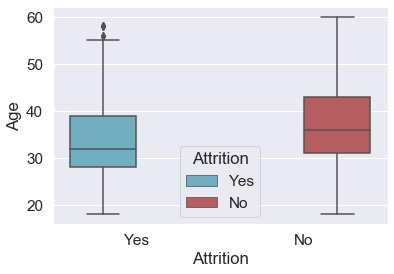

Median:
Negative: nan
Positive: nan


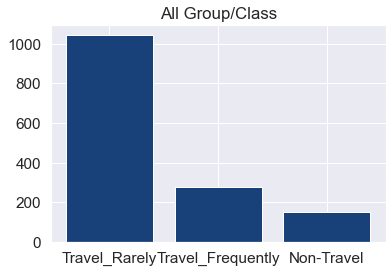

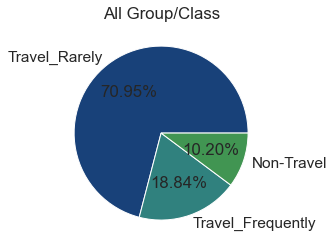

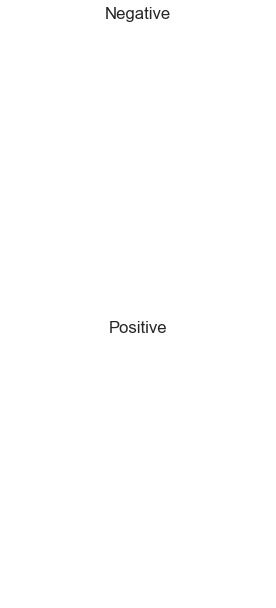

Most:
Negative: Series([], Name: BusinessTravel, dtype: int64)
Positive: Series([], Name: BusinessTravel, dtype: int64)


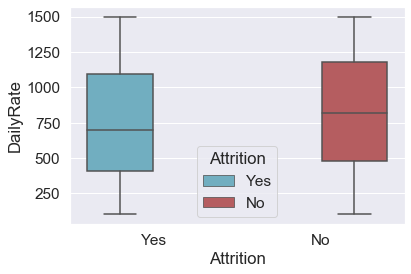

Median:
Negative: nan
Positive: nan


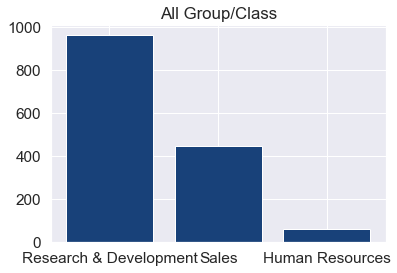

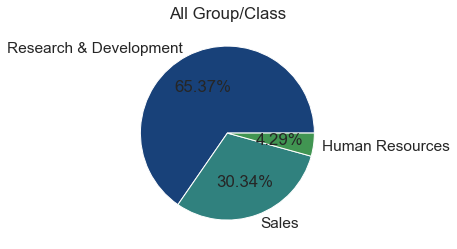

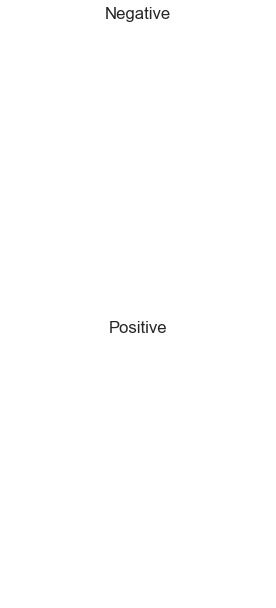

Most:
Negative: Series([], Name: Department, dtype: int64)
Positive: Series([], Name: Department, dtype: int64)


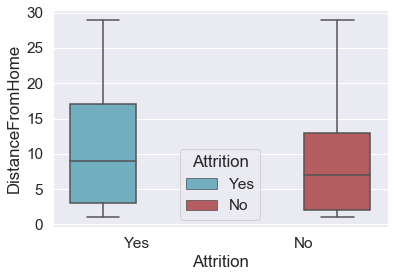

Median:
Negative: nan
Positive: nan


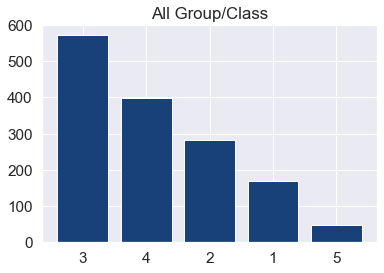

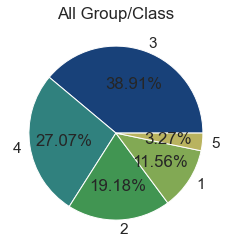

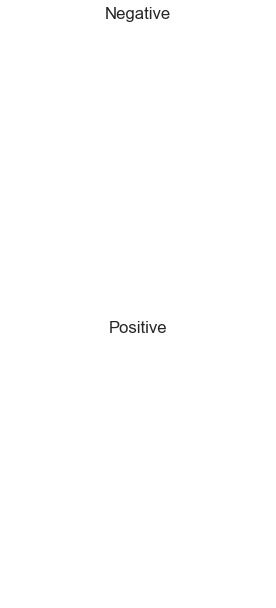

Most:
Negative: Series([], Name: Education, dtype: int64)
Positive: Series([], Name: Education, dtype: int64)


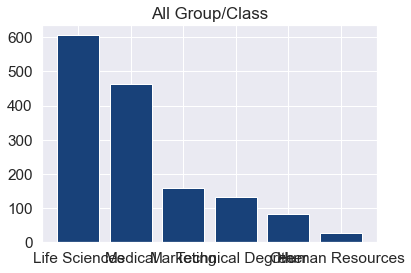

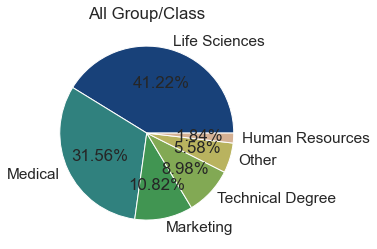

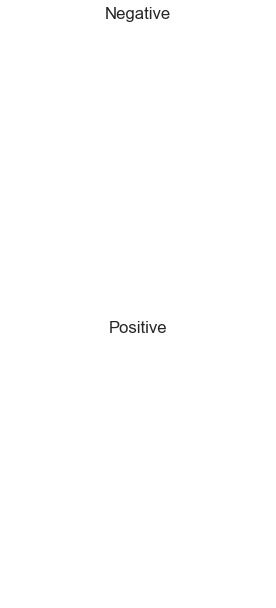

Most:
Negative: Series([], Name: EducationField, dtype: int64)
Positive: Series([], Name: EducationField, dtype: int64)


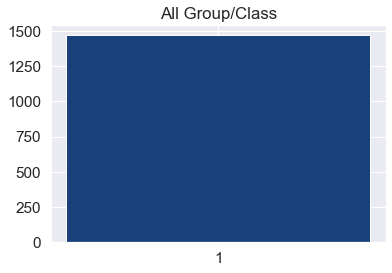

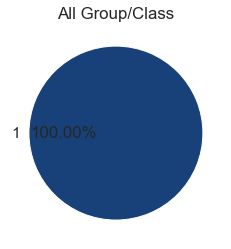

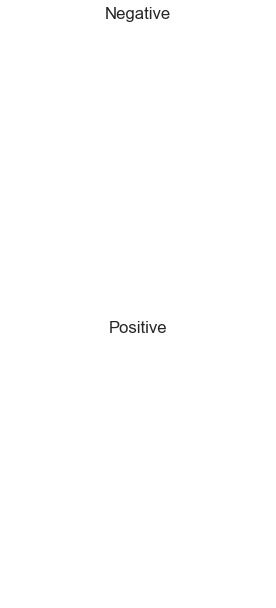

Most:
Negative: Series([], Name: EmployeeCount, dtype: int64)
Positive: Series([], Name: EmployeeCount, dtype: int64)


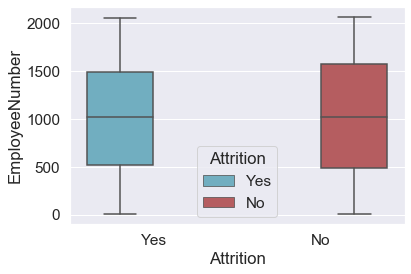

Median:
Negative: nan
Positive: nan


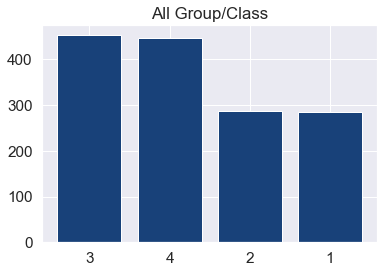

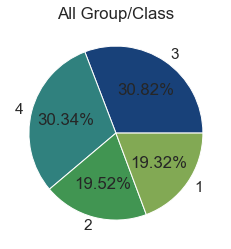

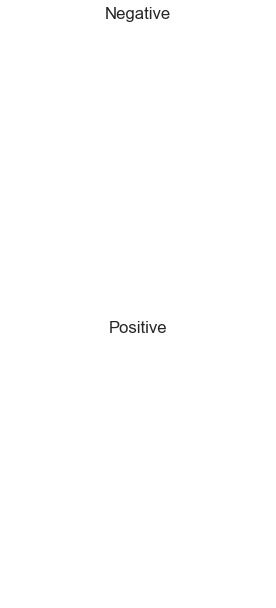

Most:
Negative: Series([], Name: EnvironmentSatisfaction, dtype: int64)
Positive: Series([], Name: EnvironmentSatisfaction, dtype: int64)


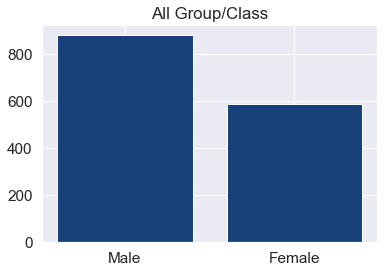

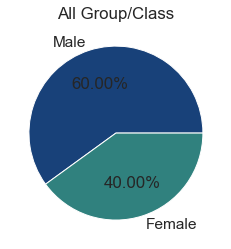

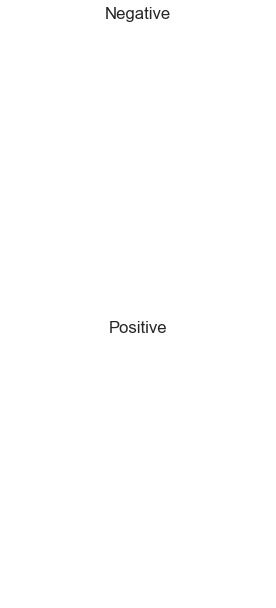

Most:
Negative: Series([], Name: Gender, dtype: int64)
Positive: Series([], Name: Gender, dtype: int64)


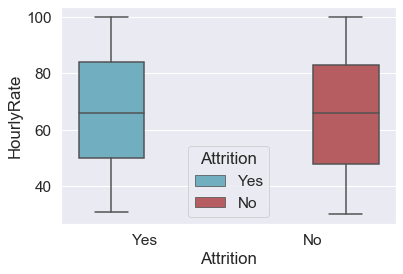

Median:
Negative: nan
Positive: nan


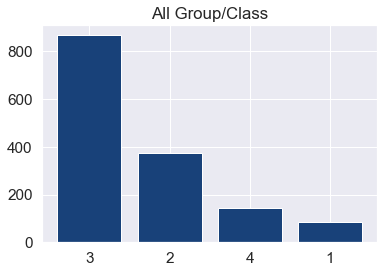

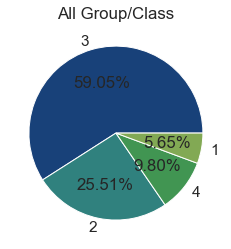

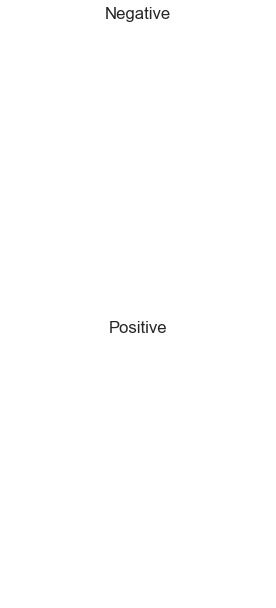

Most:
Negative: Series([], Name: JobInvolvement, dtype: int64)
Positive: Series([], Name: JobInvolvement, dtype: int64)


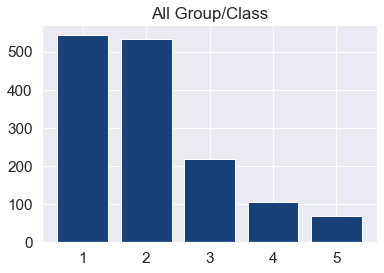

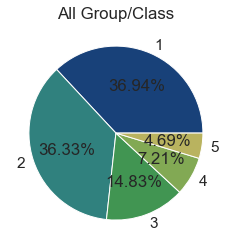

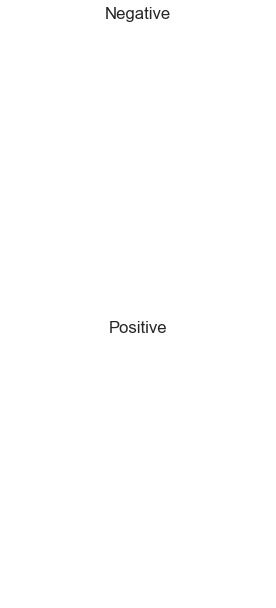

Most:
Negative: Series([], Name: JobLevel, dtype: int64)
Positive: Series([], Name: JobLevel, dtype: int64)


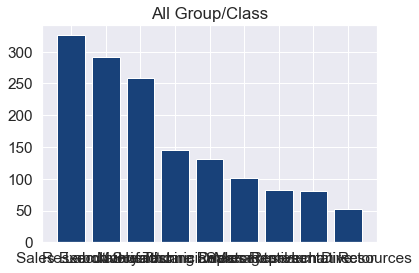

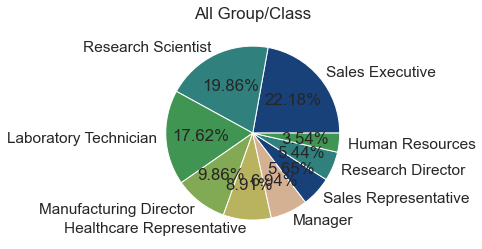

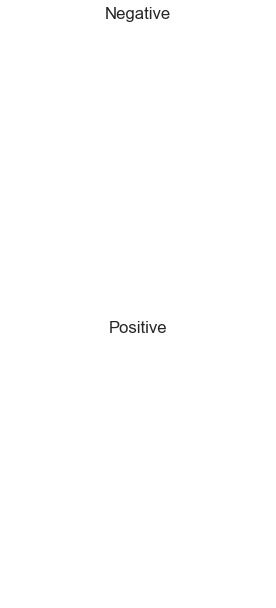

Most:
Negative: Series([], Name: JobRole, dtype: int64)
Positive: Series([], Name: JobRole, dtype: int64)


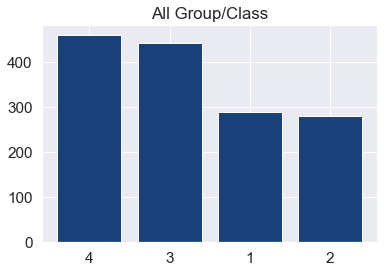

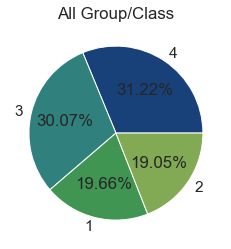

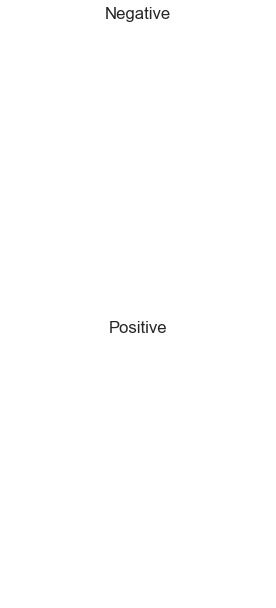

Most:
Negative: Series([], Name: JobSatisfaction, dtype: int64)
Positive: Series([], Name: JobSatisfaction, dtype: int64)


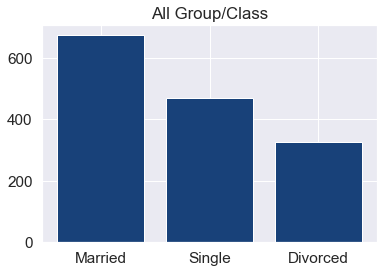

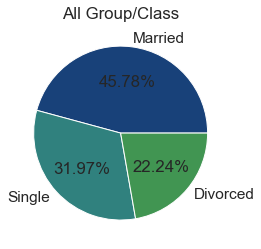

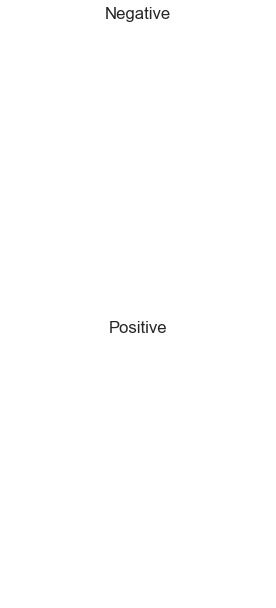

Most:
Negative: Series([], Name: MaritalStatus, dtype: int64)
Positive: Series([], Name: MaritalStatus, dtype: int64)


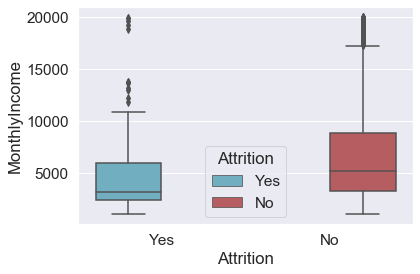

Median:
Negative: nan
Positive: nan


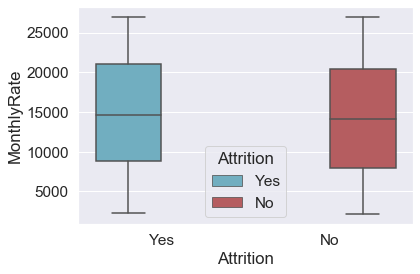

Median:
Negative: nan
Positive: nan


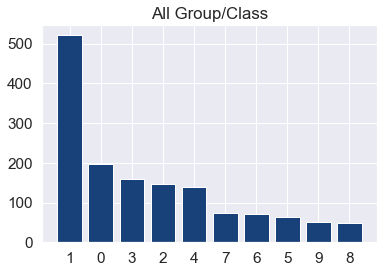

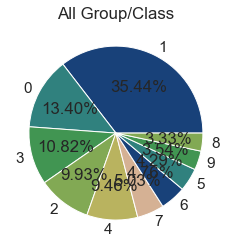

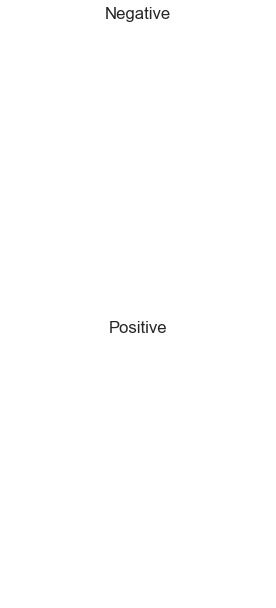

Most:
Negative: Series([], Name: NumCompaniesWorked, dtype: int64)
Positive: Series([], Name: NumCompaniesWorked, dtype: int64)


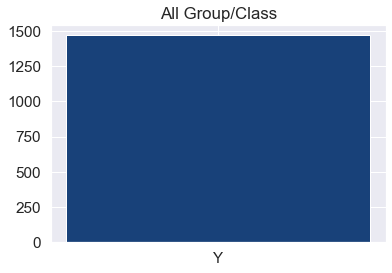

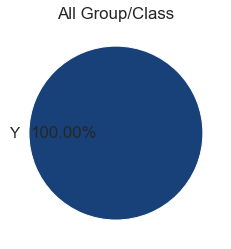

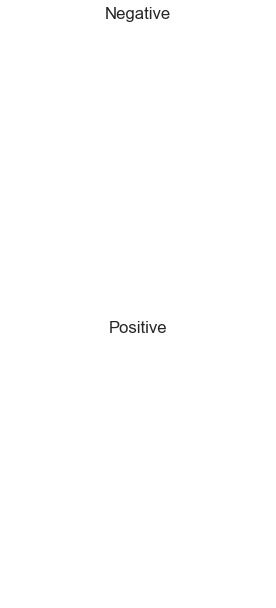

Most:
Negative: Series([], Name: Over18, dtype: int64)
Positive: Series([], Name: Over18, dtype: int64)


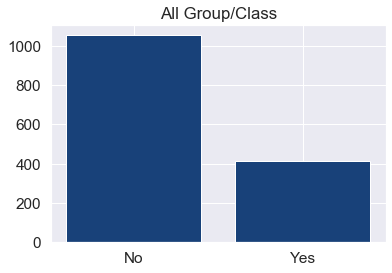

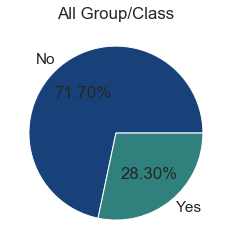

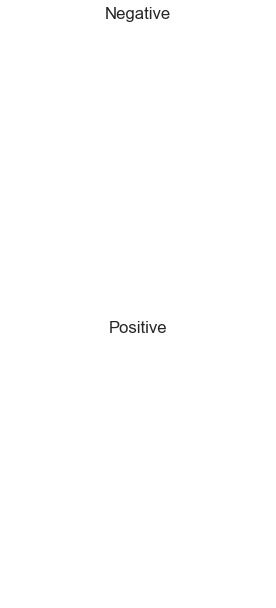

Most:
Negative: Series([], Name: OverTime, dtype: int64)
Positive: Series([], Name: OverTime, dtype: int64)


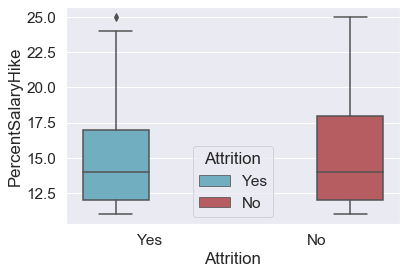

Median:
Negative: nan
Positive: nan


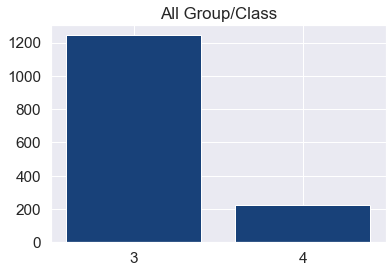

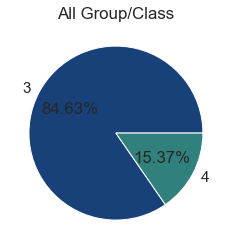

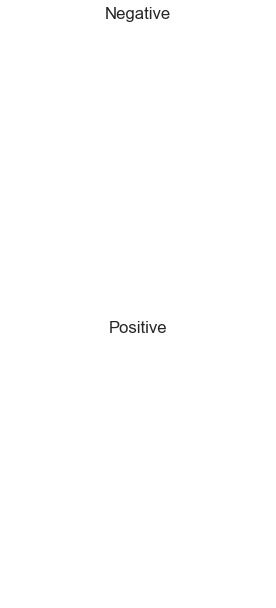

Most:
Negative: Series([], Name: PerformanceRating, dtype: int64)
Positive: Series([], Name: PerformanceRating, dtype: int64)


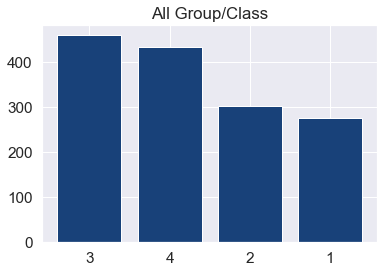

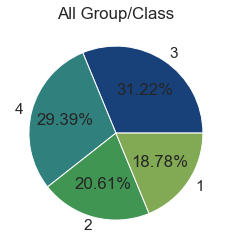

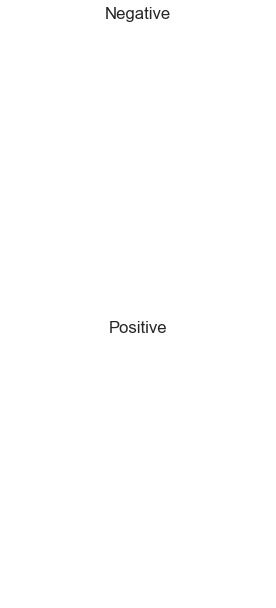

Most:
Negative: Series([], Name: RelationshipSatisfaction, dtype: int64)
Positive: Series([], Name: RelationshipSatisfaction, dtype: int64)


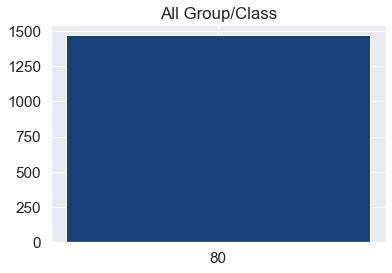

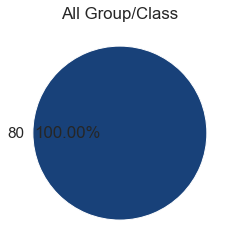

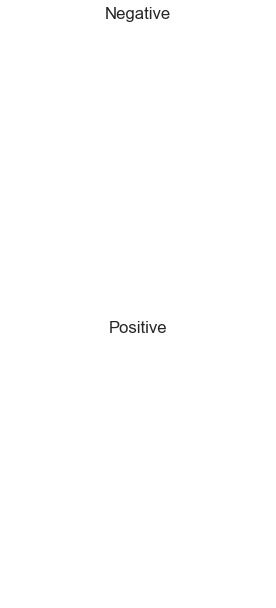

Most:
Negative: Series([], Name: StandardHours, dtype: int64)
Positive: Series([], Name: StandardHours, dtype: int64)


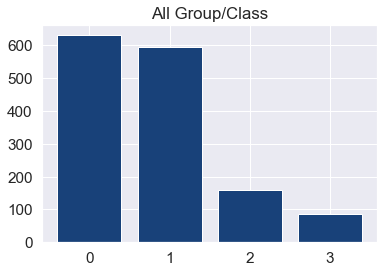

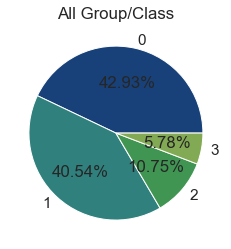

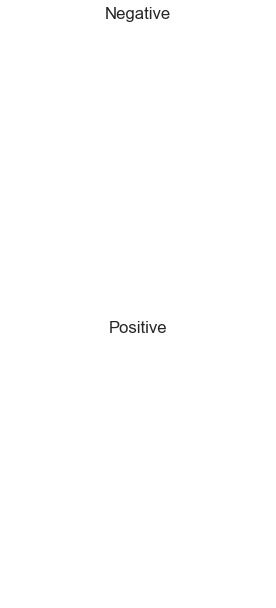

Most:
Negative: Series([], Name: StockOptionLevel, dtype: int64)
Positive: Series([], Name: StockOptionLevel, dtype: int64)


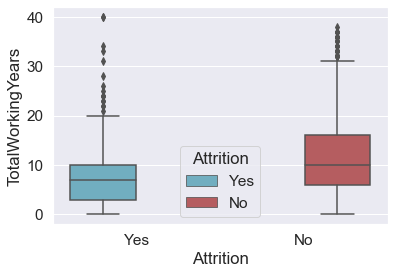

Median:
Negative: nan
Positive: nan


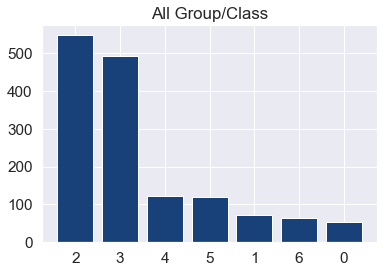

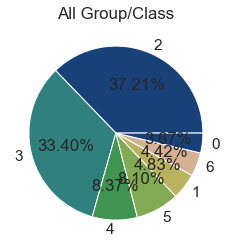

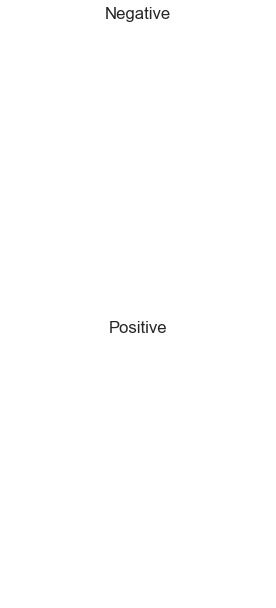

Most:
Negative: Series([], Name: TrainingTimesLastYear, dtype: int64)
Positive: Series([], Name: TrainingTimesLastYear, dtype: int64)


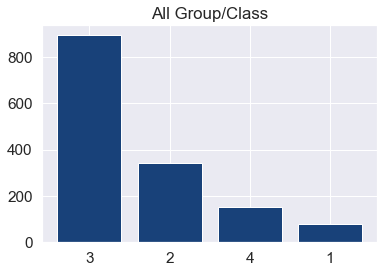

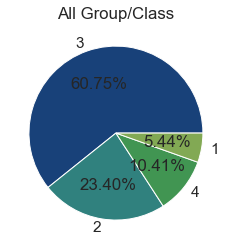

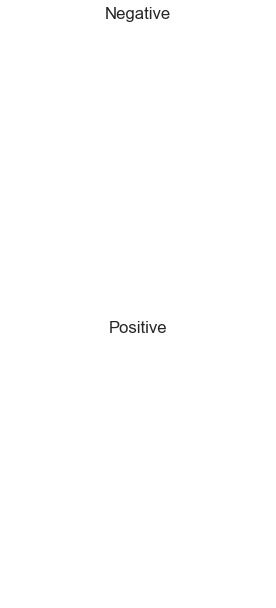

Most:
Negative: Series([], Name: WorkLifeBalance, dtype: int64)
Positive: Series([], Name: WorkLifeBalance, dtype: int64)


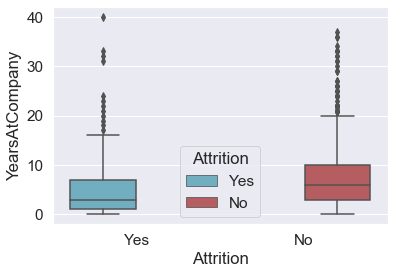

Median:
Negative: nan
Positive: nan


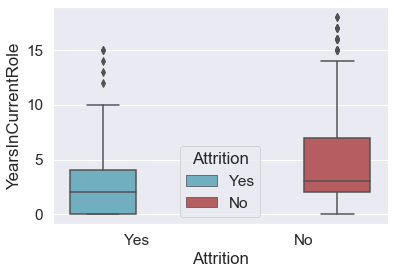

Median:
Negative: nan
Positive: nan


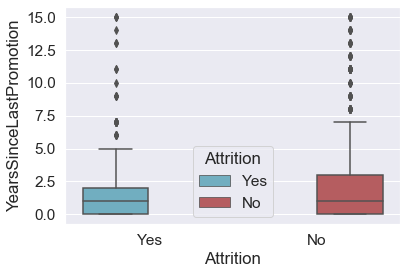

Median:
Negative: nan
Positive: nan


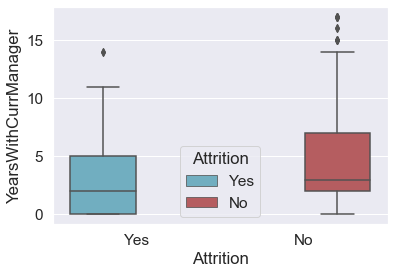

Median:
Negative: nan
Positive: nan


In [61]:
eda(df_all)

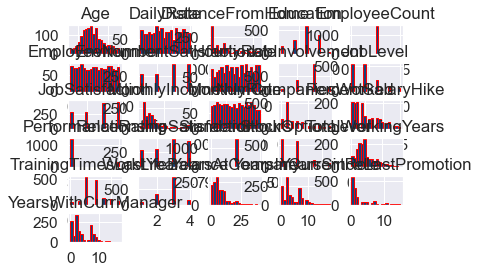

In [62]:
df.hist(edgecolor = 'Red',bins=20); 

array([[<AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'DailyRate'}>,
        <AxesSubplot:title={'center':'DistanceFromHome'}>,
        <AxesSubplot:title={'center':'Education'}>,
        <AxesSubplot:title={'center':'EmployeeCount'}>],
       [<AxesSubplot:title={'center':'EmployeeNumber'}>,
        <AxesSubplot:title={'center':'EnvironmentSatisfaction'}>,
        <AxesSubplot:title={'center':'HourlyRate'}>,
        <AxesSubplot:title={'center':'JobInvolvement'}>,
        <AxesSubplot:title={'center':'JobLevel'}>],
       [<AxesSubplot:title={'center':'JobSatisfaction'}>,
        <AxesSubplot:title={'center':'MonthlyIncome'}>,
        <AxesSubplot:title={'center':'MonthlyRate'}>,
        <AxesSubplot:title={'center':'NumCompaniesWorked'}>,
        <AxesSubplot:title={'center':'PercentSalaryHike'}>],
       [<AxesSubplot:title={'center':'PerformanceRating'}>,
        <AxesSubplot:title={'center':'RelationshipSatisfaction'}>,
        <AxesSubplot:title={'cen

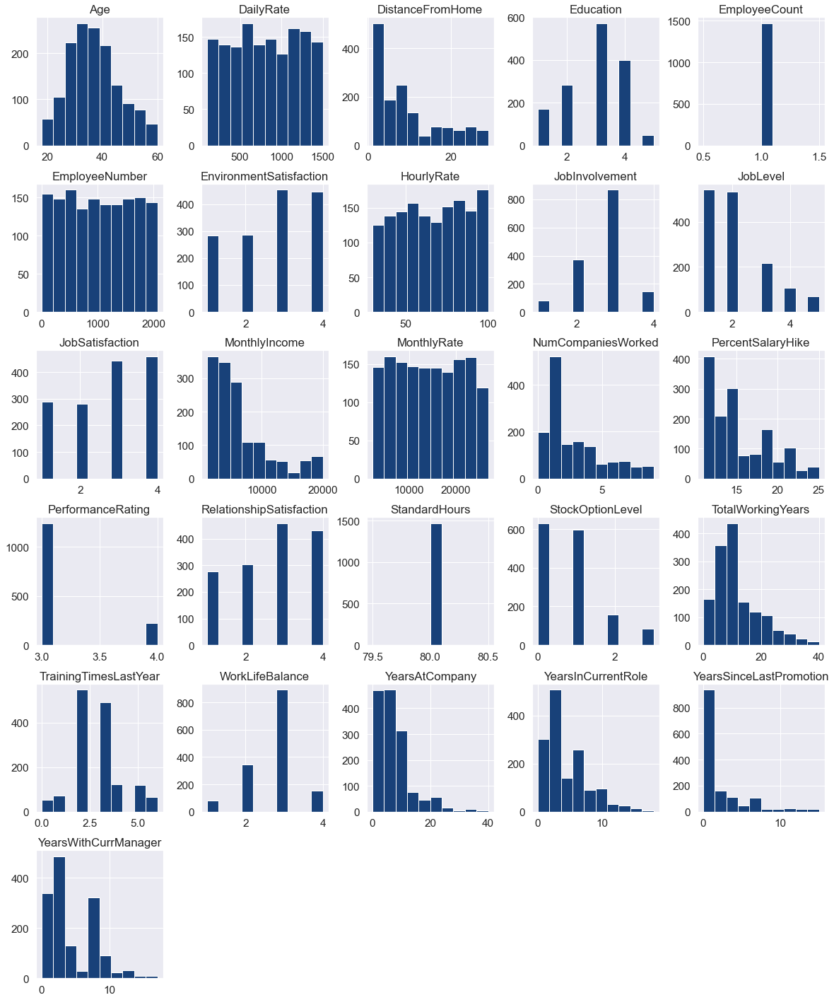

In [63]:
fig = plt.figure(figsize = (20,25))
ax = fig.gca()
df.hist(ax = ax)

Here we see that monthly income has high outliers.

In [64]:
df.corr()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,0.010661,-0.001686,0.208034,NaN,-0.010145,0.010146,0.024287,0.029820,0.509604,-0.004892,0.497855,0.028051,0.299635,0.003634,0.001904,0.053535,NaN,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
DailyRate,0.010661,1.000000,-0.004985,-0.016806,NaN,-0.050990,0.018355,0.023381,0.046135,0.002966,0.030571,0.007707,-0.032182,0.038153,0.022704,0.000473,0.007846,NaN,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
DistanceFromHome,-0.001686,-0.004985,1.000000,0.021042,NaN,0.032916,-0.016075,0.031131,0.008783,0.005303,-0.003669,-0.017014,0.027473,-0.029251,0.040235,0.027110,0.006557,NaN,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.016806,0.021042,1.000000,NaN,0.042070,-0.027128,0.016775,0.042438,0.101589,-0.011296,0.094961,-0.026084,0.126317,-0.011111,-0.024539,-0.009118,NaN,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EmployeeCount,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EmployeeNumber,-0.010145,-0.050990,0.032916,0.042070,NaN,1.000000,0.017621,0.035179,-0.006888,-0.018519,-0.046247,-0.014829,0.012648,-0.001251,-0.012944,-0.020359,-0.069861,NaN,0.062227,-0.014365,0.023603,0.010309,-0.011240,-0.008416,-0.009019,-0.009197
EnvironmentSatisfaction,0.010146,0.018355,-0.016075,-0.027128,NaN,0.017621,1.000000,-0.049857,-0.008278,0.001212,-0.006784,-0.006259,0.037600,0.012594,-0.031701,-0.029548,0.007665,NaN,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999
HourlyRate,0.024287,0.023381,0.031131,0.016775,NaN,0.035179,-0.049857,1.000000,0.042861,-0.027853,-0.071335,-0.015794,-0.015297,0.022157,-0.009062,-0.002172,0.001330,NaN,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123
JobInvolvement,0.029820,0.046135,0.008783,0.042438,NaN,-0.006888,-0.008278,0.042861,1.000000,-0.012630,-0.021476,-0.015271,-0.016322,0.015012,-0.017205,-0.029071,0.034297,NaN,0.021523,-0.005533,-0.015338,-0.014617,-0.021355,0.008717,-0.024184,0.025976
JobLevel,0.509604,0.002966,0.005303,0.101589,NaN,-0.018519,0.001212,-0.027853,-0.012630,1.000000,-0.001944,0.950300,0.039563,0.142501,-0.034730,-0.021222,0.021642,NaN,0.013984,0.782208,-0.018191,0.037818,0.534739,0.389447,0.353885,0.375281


<AxesSubplot:>

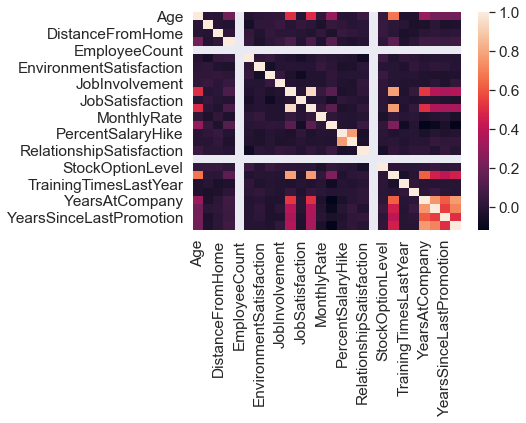

In [65]:
sns.heatmap(df.corr())

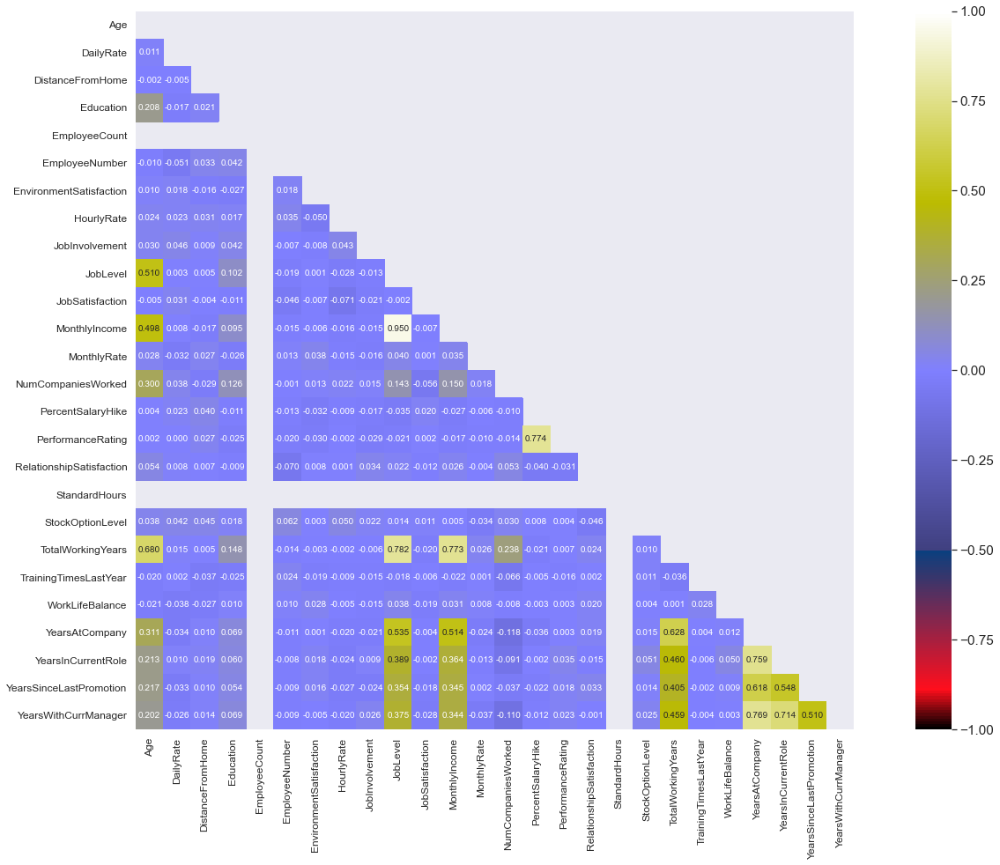

In [66]:
upper_triangle = np.triu(df.corr())
plt.figure(figsize=(25,15))
sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', 
            annot_kws={'size':10}, cmap="gist_stern", mask=upper_triangle)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

## OBSERVATION:

<b> Age, JobLevel, MonthlyIncome is highly positively correlated with TotalWorkingYears </b>.

<b> JobLevel is highly positively correlated with the MonthlyIncome </b> .

<b> PercentSalaryHike is highly positively correlated with the column PerformanceRating </b>.

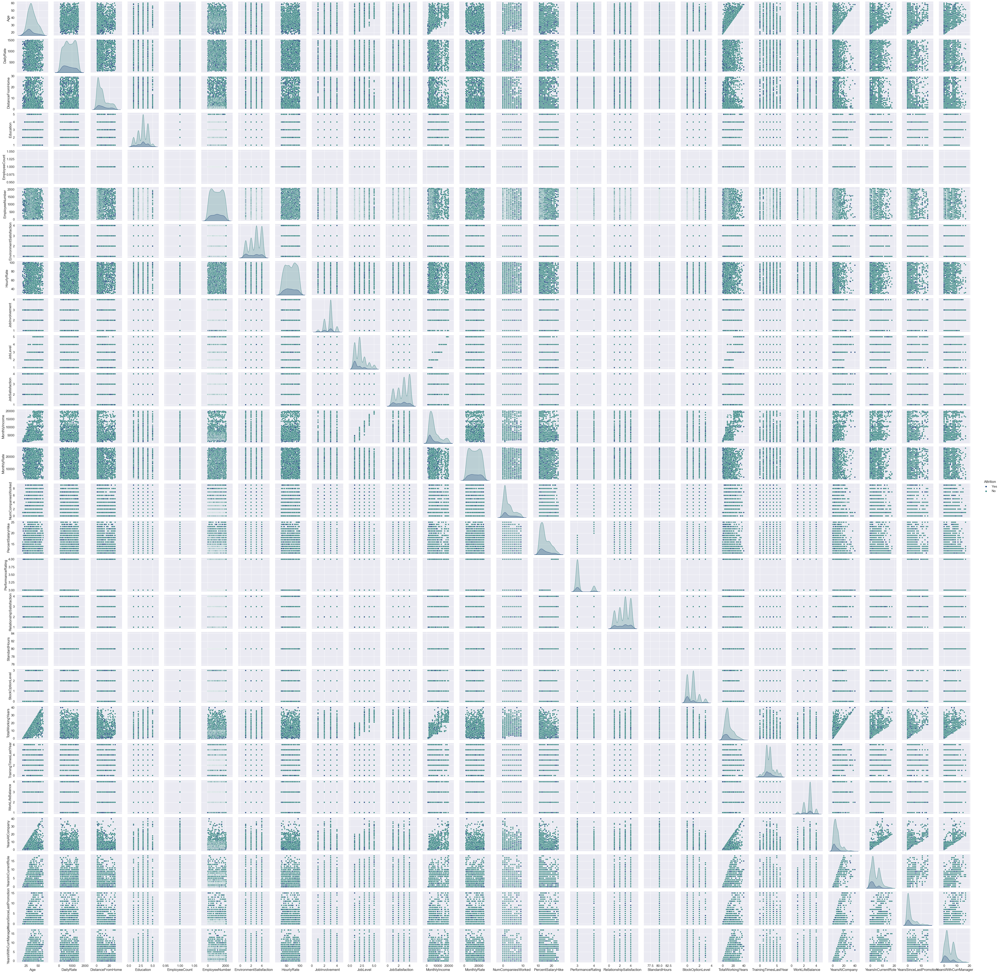

In [67]:
#pair ploting for df
sns.pairplot(df,hue="Attrition")

### Now we will do the feature engineering

## 1. We will do Label Encoding

In [68]:
# Using Label Encoder on target variable
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df["Attrition"] = le.fit_transform(df["Attrition"])
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2


In [69]:
# Droping unnecessary columns
df.drop(["EmployeeCount", "EmployeeNumber", "Over18", "StandardHours"], axis=1, inplace=True)

In [70]:
df.shape

(1470, 31)

In [71]:
# Ordinal Encoding for ordinal variables
from sklearn.preprocessing import OrdinalEncoder
oe = OrdinalEncoder()
def ordinal_encode(df, column):
    df[column] = oe.fit_transform(df[column])
    return df

oe_col = ['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'OverTime']
df=ordinal_encode(df, oe_col)
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,2.0,1102,2.0,1,2,1.0,2,0.0,94,3,2,7.0,4,2.0,5993,19479,8,1.0,11,3,1,0,8,0,1,6,4,0,5
1,49,0,1.0,279,1.0,8,1,1.0,3,1.0,61,2,2,6.0,2,1.0,5130,24907,1,0.0,23,4,4,1,10,3,3,10,7,1,7
2,37,1,2.0,1373,1.0,2,2,4.0,4,1.0,92,2,1,2.0,3,2.0,2090,2396,6,1.0,15,3,2,0,7,3,3,0,0,0,0
3,33,0,1.0,1392,1.0,3,4,1.0,4,0.0,56,3,1,6.0,3,1.0,2909,23159,1,1.0,11,3,3,0,8,3,3,8,7,3,0
4,27,0,2.0,591,1.0,2,1,3.0,1,1.0,40,3,1,2.0,2,1.0,3468,16632,9,0.0,12,3,4,1,6,3,3,2,2,2,2


## Outliers Detection and Removal

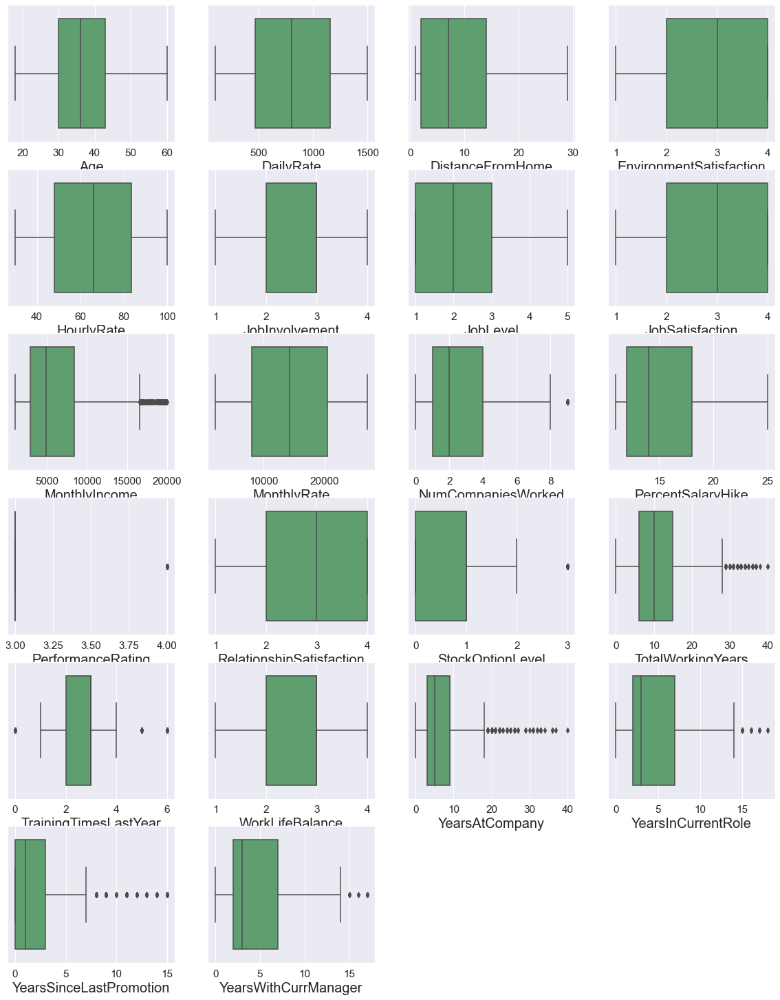

In [72]:
plt.figure(figsize=(20,30),facecolor='white')
plotnumber=1

for column in Num_features:
    if plotnumber<=28:
        ax=plt.subplot(7,4,plotnumber)
        sns.boxplot(df[column],color='g')
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()

Features containing outliers
"MonthlyIncome", "NumCompaniesWorked", "PerformanceRating", "StockOptionLevel", "TotalWorkingYears", "TrainingTimesLastYear", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager", "Attrition".

In [73]:
from scipy.stats import zscore
z = np.abs(zscore(df))
threshold = 3
df1 = df[(z<3).all(axis = 1)]

print ("Shape of the dataframe before removing outliers: ", df.shape)
print ("Shape of the dataframe after removing outliers: ", df1.shape)
print ("Percentage of data loss post outlier removal: ", (df.shape[0]-df1.shape[0])/df.shape[0]*100)

df=df1.copy() # reassigning the changed dataframe name to our original dataframe name

Shape of the dataframe before removing outliers:  (1470, 31)
Shape of the dataframe after removing outliers:  (1387, 31)
Percentage of data loss post outlier removal:  5.646258503401361


## DATA LOSS

In [74]:
print("\033[1m"+'Percentage Data Loss :'+"\033[0m",((1470-1387)/1470)*100,'%')

Percentage Data Loss : 5.646258503401361 %


### 2. Skewness of feature

## Transforming skew data using power transform

In [75]:
df1.skew()

Age                         0.472280
Attrition                   1.805983
BusinessTravel             -1.426774
DailyRate                  -0.017078
Department                  0.183919
DistanceFromHome            0.954752
Education                  -0.289024
EducationField              0.544868
EnvironmentSatisfaction    -0.325285
Gender                     -0.417296
HourlyRate                 -0.030481
JobInvolvement             -0.501401
JobLevel                    1.126075
JobRole                    -0.386843
JobSatisfaction            -0.345612
MaritalStatus              -0.160952
MonthlyIncome               1.544770
MonthlyRate                 0.030596
NumCompaniesWorked          1.037715
OverTime                    0.954751
PercentSalaryHike           0.800592
PerformanceRating           1.931566
RelationshipSatisfaction   -0.295686
StockOptionLevel            0.962332
TotalWorkingYears           1.034487
TrainingTimesLastYear       0.577614
WorkLifeBalance            -0.557100
Y

In [76]:
fea=["DistanceFromHome","MonthlyIncome","NumCompaniesWorked","PercentSalaryHike","TotalWorkingYears","TrainingTimesLastYear","YearsAtCompany","YearsInCurrentRole"]

In [77]:
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
'''
parameters:
method = 'box_cox' or 'yeo-johnson'
'''

"\nparameters:\nmethod = 'box_cox' or 'yeo-johnson'\n"

In [78]:
df1[fea] = scaler.fit_transform(df1[fea].values)

In [79]:
df1[fea].skew()

DistanceFromHome        -0.008149
MonthlyIncome            0.027700
NumCompaniesWorked       0.016175
PercentSalaryHike        0.112128
TotalWorkingYears       -0.009666
TrainingTimesLastYear    0.057949
YearsAtCompany          -0.025230
YearsInCurrentRole      -0.069631
dtype: float64

In [80]:
df1.corr()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,-0.159366,0.022340,0.021946,-0.038242,-0.028793,0.198502,-0.032676,0.014098,-0.039430,0.025465,0.036424,0.453902,-0.112957,0.011763,-0.104372,0.436543,0.026954,0.339436,0.034180,0.013248,-0.000617,0.041744,0.054506,0.634884,-0.013707,-0.016913,0.174149,0.118454,0.103632,0.121747
Attrition,-0.159366,1.000000,-0.001041,-0.057220,0.063637,0.080979,-0.032703,0.023585,-0.112393,0.036252,-0.001532,-0.133957,-0.171968,0.064283,-0.114206,0.160960,-0.207280,0.014888,0.047508,0.257237,-0.017523,0.010781,-0.052344,-0.136676,-0.220878,-0.059071,-0.062492,-0.201954,-0.187047,-0.029263,-0.162297
BusinessTravel,0.022340,-0.001041,1.000000,-0.004606,-0.003521,-0.015034,-0.010560,0.022576,0.001183,-0.025364,0.025424,0.028261,0.018996,0.000213,-0.032491,0.018687,0.028387,-0.010307,0.026929,0.022378,-0.027934,-0.018274,-0.029660,-0.015159,0.031888,0.011688,-0.014140,-0.021107,-0.032472,-0.027283,-0.044321
DailyRate,0.021946,-0.057220,-0.004606,1.000000,-0.005398,-0.003967,-0.018442,0.040645,0.033123,-0.005242,0.014279,0.048004,0.022978,-0.015437,0.042698,-0.074113,0.029530,-0.029844,0.033388,0.020294,0.028690,0.000574,0.004516,0.048361,0.043307,0.006581,-0.044266,0.005806,0.020542,-0.043870,-0.011516
Department,-0.038242,0.063637,-0.003521,-0.005398,1.000000,0.037660,0.012846,0.013432,-0.014540,-0.030618,-0.002412,-0.024040,0.126809,0.678627,0.029521,0.052086,0.154056,0.022741,-0.034028,0.014908,-0.015322,-0.039364,-0.037705,-0.003424,-0.007789,0.039412,0.026978,0.026334,0.057983,0.048931,0.034216
DistanceFromHome,-0.028793,0.080979,-0.015034,-0.003967,0.037660,1.000000,0.003595,0.011891,-0.012075,0.010557,0.014926,0.036805,-0.004225,0.009353,-0.019334,-0.027275,0.000545,0.048976,-0.010318,0.036524,0.034946,0.013212,0.010099,0.031353,-0.012129,-0.015334,-0.027681,0.006570,0.013091,-0.003226,0.001761
Education,0.198502,-0.032703,-0.010560,-0.018442,0.012846,0.003595,1.000000,-0.038017,-0.026223,-0.019166,0.010848,0.041343,0.083065,0.015140,-0.007219,-0.012726,0.111594,-0.018540,0.137958,-0.017166,-0.002478,-0.023487,-0.002393,0.028494,0.152263,-0.023484,0.007844,0.038266,0.050563,0.042517,0.031210
EducationField,-0.032676,0.023585,0.022576,0.040645,0.013432,0.011891,-0.038017,1.000000,0.047924,0.010676,-0.006539,-0.006876,-0.035795,0.017492,-0.050934,0.012073,-0.032707,-0.023384,-0.007901,0.007912,-0.005811,-0.003621,-0.013734,-0.015355,-0.008101,0.048844,0.034038,0.002739,0.002909,0.034094,0.013437
EnvironmentSatisfaction,0.014098,-0.112393,0.001183,0.033123,-0.014540,-0.012075,-0.026223,0.047924,1.000000,-0.015715,-0.040459,-0.012720,0.013835,-0.022354,-0.011186,-0.012453,-0.012444,0.032916,0.008870,0.059355,-0.027060,-0.025299,0.018414,0.013330,-0.014091,-0.016757,0.032492,0.014305,0.031007,0.027943,0.001606
Gender,-0.039430,0.036252,-0.025364,-0.005242,-0.030618,0.010557,-0.019166,0.010676,-0.015715,1.000000,0.004768,0.011939,-0.056970,-0.036831,0.036302,-0.056786,-0.052340,-0.045850,-0.033345,-0.051558,0.010984,-0.010757,0.041458,0.026438,-0.049776,-0.039213,0.000134,-0.046018,-0.028101,-0.028162,-0.036280


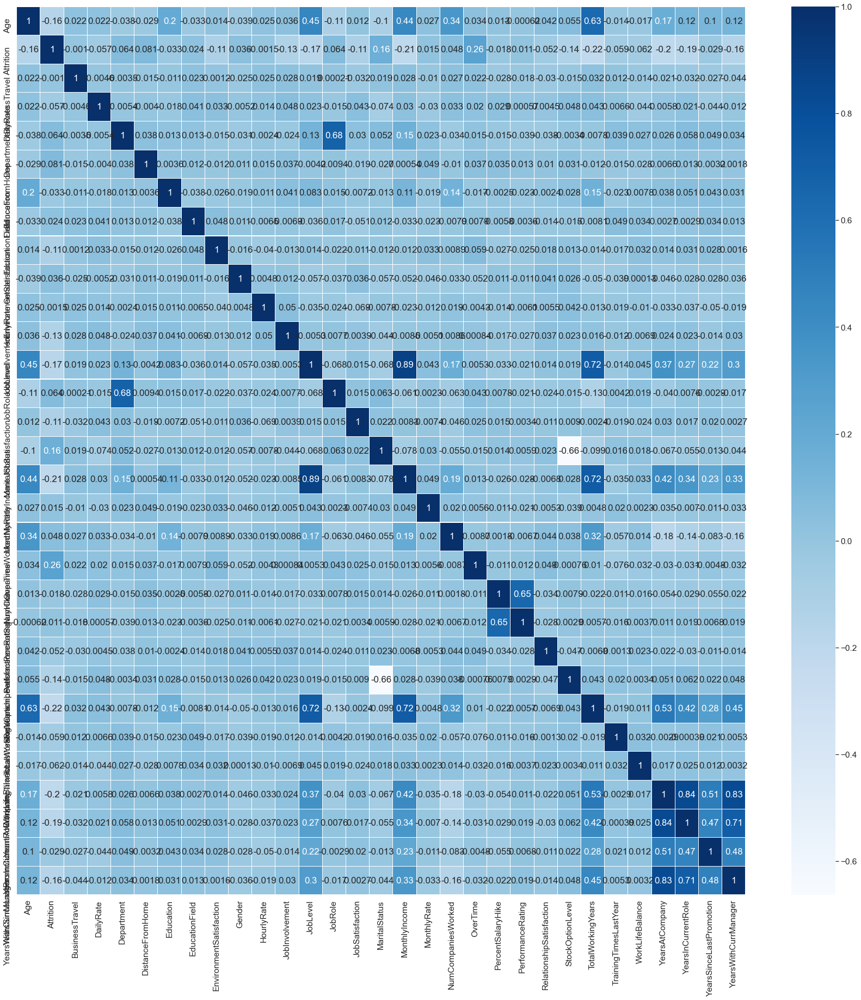

In [81]:
plt.figure(figsize=(30,30))
sns.heatmap(df1.corr(),linewidths=.1,cmap="Blues",annot=True)
plt.yticks(rotation=90);

___Observations:___

____Very light and very dark shaded blocks are higly correlated.___

____Job level and Monthly income are highly correlated.___

____YearsAtCompany and YearsInCurrentRole are higly correlated___

____YearsAtCompany and YearsWithCurrManager are higly correlated.___

____By looking the target correlation it looks difficult to analyse so let me plot bar graph for target correlation.___

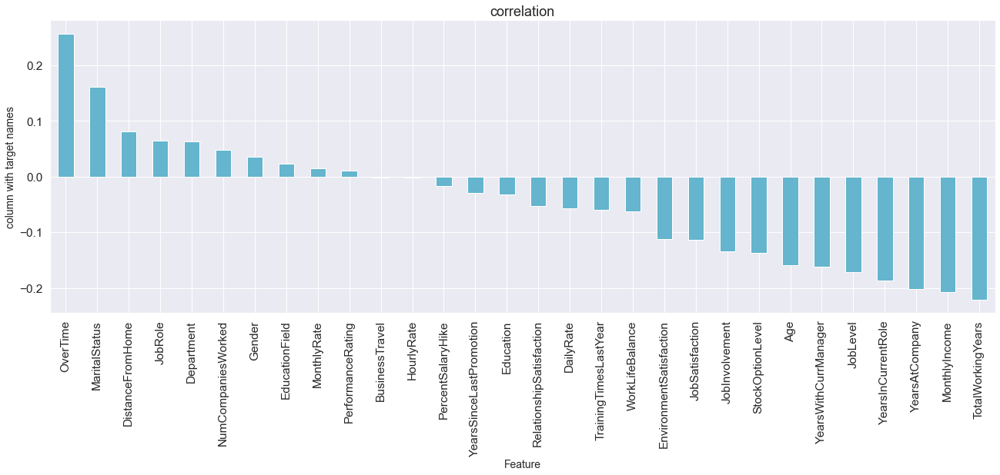

In [82]:
plt.figure(figsize=(22,7))
df1.corr()['Attrition'].sort_values(ascending=False).drop(['Attrition']).plot(kind='bar',color='c')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

BusinessTravel and HourlyRate are less correlated with target feature so we will drop them.

In [83]:
#Droping BusinessTravel, HourlyRate feature since it is less correlated with target variable.
df1 = df1.drop(["BusinessTravel","HourlyRate"],axis=1)

In [84]:
df1

,Age,Attrition,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,1102,2.0,-1.489968,2,1.0,2,0.0,3,2,7.0,4,2.0,0.386674,19479,1.620671,1.0,-1.495549,3,1,0,-0.173231,-2.608524,1,0.231837,0.290524,0,5
1,49,0,279,1.0,0.244561,1,1.0,3,1.0,2,2,6.0,2,1.0,0.144235,24907,-0.561880,0.0,1.690425,4,4,1,0.147620,0.217074,3,0.948319,1.006575,1,7
2,37,1,1373,1.0,-1.028366,2,4.0,4,1.0,2,1,2.0,3,2.0,-1.431153,2396,1.273711,1.0,0.193797,3,2,0,-0.351153,0.217074,3,-2.156089,-1.571814,0,0
3,33,0,1392,1.0,-0.698191,4,1.0,4,0.0,3,1,6.0,3,1.0,-0.814425,23159,-0.561880,1.0,-1.495549,3,3,0,-0.173231,0.217074,3,0.621429,1.006575,3,0
4,27,0,591,1.0,-1.028366,1,3.0,1,1.0,3,1,2.0,2,1.0,-0.504453,16632,1.764103,0.0,-0.957525,3,4,1,-0.544046,0.217074,3,-0.933983,-0.390769,2,2
5,32,0,1005,1.0,-1.028366,2,1.0,4,1.0,3,1,2.0,4,2.0,-0.719303,11864,-1.657926,0.0,-0.508918,3,3,0,-0.173231,-0.579974,2,0.436162,1.006575,3,6
6,59,0,1324,1.0,-0.698191,3,3.0,3,0.0,4,1,2.0,1,1.0,-0.970035,9964,0.798319,1.0,1.285201,4,1,3,0.432767,0.217074,2,-1.419662,-1.571814,0,0
7,30,0,1358,1.0,1.458012,1,1.0,4,1.0,3,1,2.0,3,0.0,-0.954333,13335,-0.561880,0.0,1.569155,4,2,1,-1.969680,-0.579974,3,-1.419662,-1.571814,0,0
8,38,0,216,1.0,1.408969,3,1.0,4,1.0,2,3,4.0,3,2.0,1.061752,8787,-1.657926,0.0,1.434784,4,2,0,0.147620,-0.579974,3,0.791264,1.006575,1,8
9,36,0,1299,1.0,1.594411,3,3.0,3,1.0,3,2,0.0,3,1.0,0.176904,16577,1.273711,0.0,-0.508918,3,2,2,1.039364,0.217074,2,0.436162,1.006575,7,7


## Now We will Pre Process the data 

In [85]:
x = df1.drop("Attrition",axis=1)
y = df1["Attrition"]

In [86]:
y.value_counts()

0    1158
1     229
Name: Attrition, dtype: int64

 As we are able to see Target data is imbalanced so, firstly we will go to balance it.

## We will Balance the dataset using SMOTE

In [87]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x, y = SM.fit_resample(x,y)

In [88]:
# Checking the value counts again
y.value_counts()

0    1158
1    1158
Name: Attrition, dtype: int64

<AxesSubplot:xlabel='Attrition', ylabel='count'>

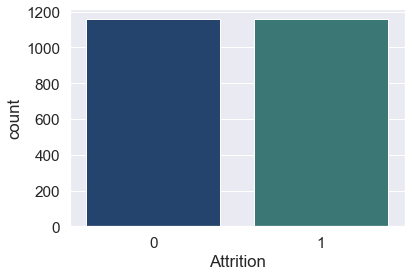

In [89]:
# Visualizing the data after oversampling
sns.countplot(y)

## Scaling the data using StandardScaler:

In [90]:
#importing necessary libraries
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

In [91]:
ssc=StandardScaler()
X_scaled = pd.DataFrame(ssc.fit_transform(x), columns=x.columns)

## Now we Will check multicolinearity

In [92]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["vif_Features"]=[variance_inflation_factor(X_scaled.values, i) for i in range(X_scaled.shape[1])]
vif["Features"]=X_scaled.columns
vif

,vif_Features,Features
0,1.974429,Age
1,1.049623,DailyRate
2,2.323491,Department
3,1.029815,DistanceFromHome
4,1.093686,Education
5,1.043379,EducationField
6,1.071523,EnvironmentSatisfaction
7,1.028481,Gender
8,1.094604,JobInvolvement
9,4.142546,JobLevel


We can observed that multicollinerity is within permissible limit of 10

## Now we deploy the Machine Learning Model

## 1.Finding Best RandomState and Accuracy:

In [93]:
from sklearn.linear_model import LogisticRegression
maxAccu=0
maxRS=0
LR=LogisticRegression
for i in range(1,200):
    X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =i)
    mod = LR()
    mod.fit(X_train, y_train)
    pred = mod.predict(X_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.5441677044416771  on Random_state  194


In [94]:
# Now we will split the data into x train, y train 
X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =75)
print('Training feature matrix size:',X_train.shape)
print('Training target vector size:',y_train.shape)
print('Test feature matrix size:',X_test.shape)
print('Test target vector size:',y_test.shape)

Training feature matrix size: (1621, 28)
Training target vector size: (1621,)
Test feature matrix size: (695, 28)
Test target vector size: (695,)


## Now we will apply classification algorithm for Machine Learning

In [95]:
#importing necessary libraries.
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier as KNN
from sklearn.naive_bayes import GaussianNB as NB
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, roc_auc_score, accuracy_score

## 1. Logistic Regression

In [96]:
LR=LogisticRegression()
LR.fit(X_train,y_train)
predlr=LR.predict(X_test)
print('Accuracy Score:',accuracy_score(y_test, predlr))
print('Confusion Matrix:',confusion_matrix(y_test, predlr))
print(classification_report(y_test,predlr))

Accuracy Score: 0.8719424460431655
Confusion Matrix: [[305  40]
 [ 49 301]]
              precision    recall  f1-score   support

           0       0.86      0.88      0.87       345
           1       0.88      0.86      0.87       350

    accuracy                           0.87       695
   macro avg       0.87      0.87      0.87       695
weighted avg       0.87      0.87      0.87       695



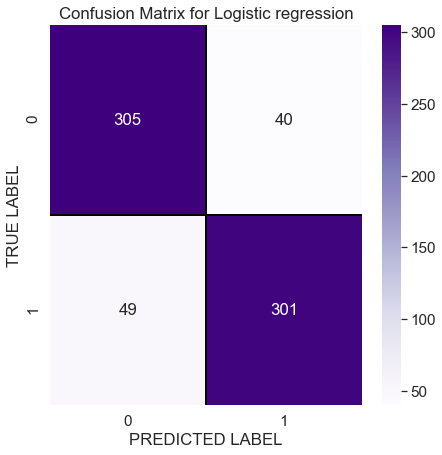

In [97]:
cm = confusion_matrix(y_test, predlr)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Logistic regression')
plt.show()


In [98]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(LR, X_scaled, y, cv =5)
print('\033[1m'+'Cross Validation Score', LR, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score LogisticRegression() :

CVScore : [0.72413793 0.88336933 0.89200864 0.86177106 0.88552916]
Mean CV Score : 0.8493632233559246
Std deviation : 0.06343240470252738


## 2.Decision Tree Classifier:

In [99]:
X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =75)
DTC=DecisionTreeClassifier()
DTC.fit(X_train,y_train)
preddt=DTC.predict(X_test)
print('Accuracy Score:',accuracy_score(y_test, preddt))
print('Confusion Matrix:',confusion_matrix(y_test, preddt))
print(classification_report(y_test,preddt))

Accuracy Score: 0.8359712230215828
Confusion Matrix: [[286  59]
 [ 55 295]]
              precision    recall  f1-score   support

           0       0.84      0.83      0.83       345
           1       0.83      0.84      0.84       350

    accuracy                           0.84       695
   macro avg       0.84      0.84      0.84       695
weighted avg       0.84      0.84      0.84       695



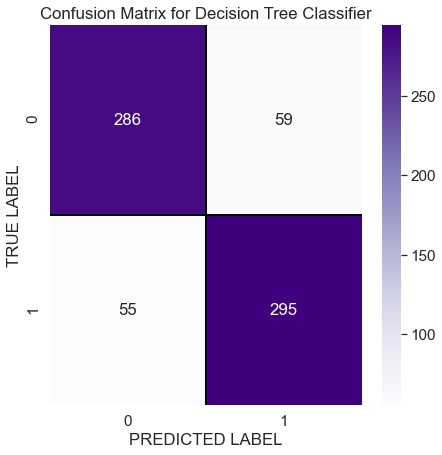

In [100]:
cm = confusion_matrix(y_test, preddt)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Decision Tree Classifier')
plt.show()

In [101]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(DTC, X_scaled, y, cv =5)
print('\033[1m'+'Cross Validation Score', DTC, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score DecisionTreeClassifier() :

CVScore : [0.67672414 0.86825054 0.85961123 0.87041037 0.86825054]
Mean CV Score : 0.8286493632233558
Std deviation : 0.07605313825301155


## 3.Random Forest Classifier:

In [102]:
X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =75)
RFC=RandomForestClassifier()
RFC.fit(X_train,y_train)
predrf=RFC.predict(X_test)
print('Accuracy Score:',accuracy_score(y_test, predrf))
print('Confusion Matrix:',confusion_matrix(y_test, predrf))
print(classification_report(y_test,predrf))

Accuracy Score: 0.920863309352518
Confusion Matrix: [[334  11]
 [ 44 306]]
              precision    recall  f1-score   support

           0       0.88      0.97      0.92       345
           1       0.97      0.87      0.92       350

    accuracy                           0.92       695
   macro avg       0.92      0.92      0.92       695
weighted avg       0.92      0.92      0.92       695



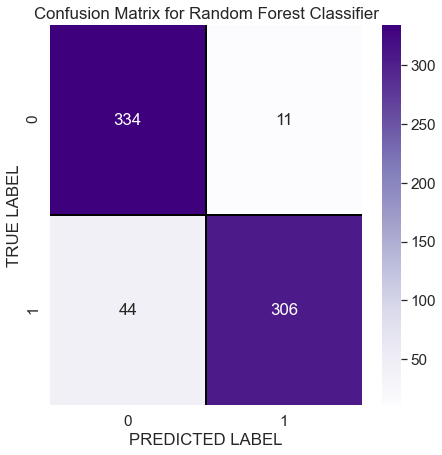

In [103]:
cm = confusion_matrix(y_test, predrf)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Random Forest Classifier')
plt.show()

In [104]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(RFC, X_scaled, y, cv =5)
print('\033[1m'+'Cross Validation Score', RFC, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score RandomForestClassifier() :

CVScore : [0.64439655 0.96760259 0.97408207 0.96112311 0.96760259]
Mean CV Score : 0.9029613837789527
Std deviation : 0.12934734851097845


## 4. Support Vector Classifier: 

In [105]:
X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =75)
SV=SVC()
SV.fit(X_train,y_train)
predsv=SV.predict(X_test)
print('Accuracy Score:',accuracy_score(y_test, predsv))
print('Confusion Matrix:',confusion_matrix(y_test, predsv))
print(classification_report(y_test,predsv))

Accuracy Score: 0.920863309352518
Confusion Matrix: [[322  23]
 [ 32 318]]
              precision    recall  f1-score   support

           0       0.91      0.93      0.92       345
           1       0.93      0.91      0.92       350

    accuracy                           0.92       695
   macro avg       0.92      0.92      0.92       695
weighted avg       0.92      0.92      0.92       695



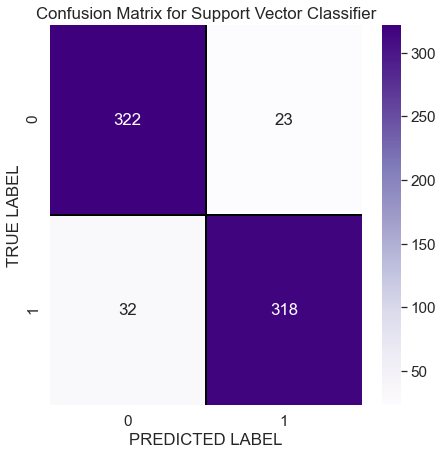

In [106]:
cm = confusion_matrix(y_test, predsv)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Support Vector Classifier')
plt.show()

In [107]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(SV, X_scaled, y, cv =5)
print('\033[1m'+'Cross Validation Score', SV, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score SVC() :

CVScore : [0.70258621 0.93304536 0.93736501 0.91792657 0.93520518]
Mean CV Score : 0.8852256647054443
Std deviation : 0.09157478595725603


## 5. K-Neighbor Classifier

In [108]:
X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =75)
knn=KNN()
knn.fit(X_train,y_train)
predkn=knn.predict(X_test)
print('Accuracy Score:',accuracy_score(y_test, predkn))
print('Confusion Matrix:',confusion_matrix(y_test, predkn))
print(classification_report(y_test,predkn))

Accuracy Score: 0.8589928057553957
Confusion Matrix: [[254  91]
 [  7 343]]
              precision    recall  f1-score   support

           0       0.97      0.74      0.84       345
           1       0.79      0.98      0.87       350

    accuracy                           0.86       695
   macro avg       0.88      0.86      0.86       695
weighted avg       0.88      0.86      0.86       695



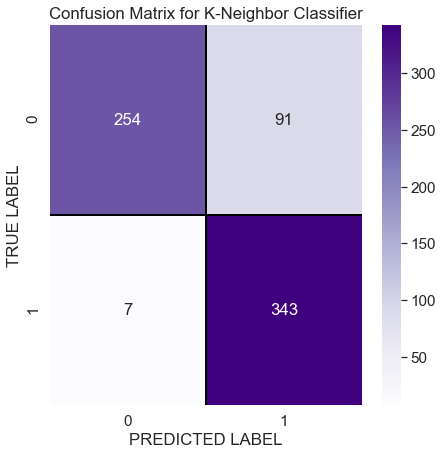

In [109]:
cm = confusion_matrix(y_test, predkn)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for K-Neighbor Classifier')
plt.show()

In [110]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(knn, X_scaled, y, cv =5)
print('\033[1m'+'Cross Validation Score', knn, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score KNeighborsClassifier() :

CVScore : [0.84482759 0.85961123 0.82289417 0.8336933  0.85961123]
Mean CV Score : 0.8441275042824159
Std deviation : 0.014420185722409672


## 6.Gradient Boosting Classifier:

In [111]:
X_train,X_test,y_train,y_test = train_test_split(X_scaled,y,test_size=.30, random_state =75)
GBC=GradientBoostingClassifier()
GBC.fit(X_train,y_train)
predgb=GBC.predict(X_test)
print('Accuracy Score:',accuracy_score(y_test, predgb))
print('Confusion Matrix:',confusion_matrix(y_test, predgb))
print(classification_report(y_test,predgb))

Accuracy Score: 0.9064748201438849
Confusion Matrix: [[327  18]
 [ 47 303]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91       345
           1       0.94      0.87      0.90       350

    accuracy                           0.91       695
   macro avg       0.91      0.91      0.91       695
weighted avg       0.91      0.91      0.91       695



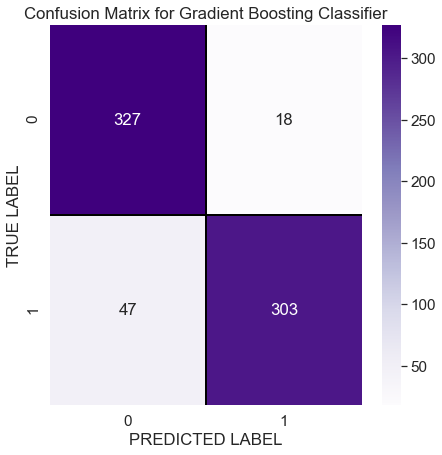

In [112]:
cm = confusion_matrix(y_test, predgb)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Gradient Boosting Classifier')
plt.show()

In [113]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(GBC, X_scaled, y, cv =5)
print('\033[1m'+'Cross Validation Score', GBC, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score GradientBoostingClassifier() :

CVScore : [0.5625     0.96976242 0.96112311 0.93736501 0.96760259]
Mean CV Score : 0.8796706263498921
Std deviation : 0.15900246349303238


__Observation:__

_After ploting various model, model no.6 Gradient Boosting Classifier having eqaul value  for accuracy and F1 score, So, Here I will consider the GBC model as best model_

## Now Plotting Hyper Para Tunning 

In [114]:
#importing necessary libraries
from sklearn.model_selection import GridSearchCV

In [115]:
print(GBC.get_params())

{'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'deviance', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': None, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}


In [117]:
parameter = { 'max_depth': [5,10,20,None], 
              'max_features': ['auto'], 
              'n_estimators': [25,50,75,100],
            'min_samples_split':[0.5,0.1,1.5,2.0],
            'subsample':[ 1.0],
             'warm_start': [False], 'min_samples_split':[1,2] }

In [119]:
GCV = GridSearchCV(GradientBoostingClassifier(),parameter,cv=5,verbose=10)
GCV.fit(X_train,y_train)

Fitting 5 folds for each of 32 candidates, totalling 160 fits
[CV 1/5; 1/32] START max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_start=False
[CV 1/5; 1/32] END max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 1/32] START max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_start=False
[CV 2/5; 1/32] END max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 1/32] START max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_start=False
[CV 3/5; 1/32] END max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 1/32] START max_depth=5, max_features=auto, min_samples_split=1, n_estimators=25, subsample=1.0, warm_st

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(),
             param_grid={'max_depth': [5, 10, 20, None],
                         'max_features': ['auto'], 'min_samples_split': [1, 2],
                         'n_estimators': [25, 50, 75, 100], 'subsample': [1.0],
                         'warm_start': [False]},
             verbose=10)

In [120]:
GCV.best_params_

{'max_depth': 5,
 'max_features': 'auto',
 'min_samples_split': 2,
 'n_estimators': 75,
 'subsample': 1.0,
 'warm_start': False}

In [121]:
Final_mod=GradientBoostingClassifier(max_depth= 10,max_features= 'auto',min_samples_split= 0.5,n_estimators= 100)
Final_mod.fit(X_train,y_train)
pred=Final_mod.predict(X_test)
print('\033[1m'+'Final Gradient Boosting Classifier'+'\033[0m')
print('\033[1m'+'Accuracy Score :'+'\033[0m\n', accuracy_score(y_test,predgb))
print('\n')
print('\033[1m'+'Confusion matrix of Gradient Boosting Classifier :'+'\033[0m \n',confusion_matrix(y_test, predgb))
print('\n')
print('\033[1m'+'Classification Report of Gradient Boosting Classifier'+'\033[0m \n',classification_report(y_test, predgb))

Final Gradient Boosting Classifier
Accuracy Score :
 0.9064748201438849


Confusion matrix of Gradient Boosting Classifier : 
 [[327  18]
 [ 47 303]]


Classification Report of Gradient Boosting Classifier 
               precision    recall  f1-score   support

           0       0.87      0.95      0.91       345
           1       0.94      0.87      0.90       350

    accuracy                           0.91       695
   macro avg       0.91      0.91      0.91       695
weighted avg       0.91      0.91      0.91       695



Text(0.5, 1.0, 'Confusion Matrix for Gradient Boosting Classifier ')

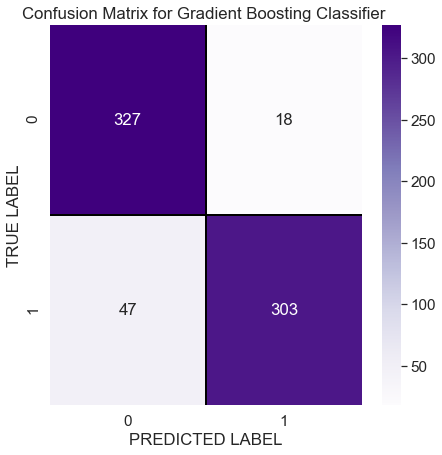

In [122]:
cm = confusion_matrix(y_test, predgb)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Gradient Boosting Classifier ')

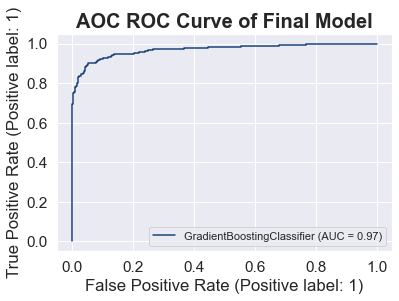

Auc Score :
 0.9125465838509317


In [123]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import plot_roc_curve
disp = plot_roc_curve(Final_mod,X_test,y_test)   
plt.legend(prop={'size':11}, loc='lower right')
plt.title('AOC ROC Curve of Final Model',fontsize=20,fontweight='bold')
plt.show()
print('='*100)
auc_score = roc_auc_score(y_test, Final_mod.predict(X_test))
print('\033[1m'+'Auc Score :'+'\033[0m\n',auc_score)

In [124]:
import joblib
joblib.dump(Final_mod,'HR_Attrition_Project.pkl')

['HR_Attrition_Project.pkl']

In [125]:
# Loading the saved model
model=joblib.load("HR_Attrition_Project.pkl")

#Prediction
prediction = model.predict(X_test)
prediction

array([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0,
       1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1,
       1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0,
       1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1,
       0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0,

In [126]:
pd.DataFrame([model.predict(X_test)[:],y_test[:]],index=["Predicted","Actual"])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694
Predicted,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,1,1,1,0,1,0,1,0,1,0,1,0,1,1,1,1,1,1,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,0,1,1,0,0,0,1,1,0,0,1,0,0,1,1,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,1,1,0,0,1,0,1,0,0,0,0,0,1,1,1,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,1,0,1,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,1,1,0,0,1,0,1,0,1,0,1,0,1,0,1,1,0,1,1,1,1,0,1,1,0,1,1,0,0,1,0,1,0,0,1,0,0,1,1,1,0,0,1,1,0,1,1,0,0,1,1,0,1,0,0,1,0,1,0,0,0,1,0,1,1,0,1,0,1,1,1,1,1,1,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1,0,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,1,1,0,1,0,1,1,0,0,0,1,0,1,1,0,1,1,1,0,1,1,1,0,0,1,0,1,1,1,1,0,1,1,0,1,1,0,0,0,1,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,1,1,0,1,0,1,0,1,0,1,0,0,1,1,0,1,1,1,1,1,1,0,0,0,0,0,1,0,1,0,0,1,1,0,1,1,0,0,1,1,0,1,1,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,1,1,1,1,1,1,0,1,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,1,0,0,0,1,0,1,0,0,0,1,0,1,1,1,0,1,0,0,1,1,0,1,1,1,0,1,1,0,1,1,1,1,1,0,0,1,1,0,0,1,1,1,1,1,0,1,1,0,1,0,1,1,0,0,0,1,1,1,0,1,1,0,1,0,1,0,0,1,1,1,0,0,0,0,0,0,1,1,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,1,1,0,0,1,1,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,1,1,0,1,1,1,1,0,0,0,0,0,1,0,0,0,0,0,1,1,1,1,1,1,1,0,1,0,1,1,1,1,1,0,0,1,1,1,0,1,0,1,0,1,1,0,0,0,1,0,1,1,1,0,0,1,0,0,1,1,0,0,0,1,1,1,0,1,1,0,0,0,1,1,0,1,0,0

## Finding importance Features

<AxesSubplot:>

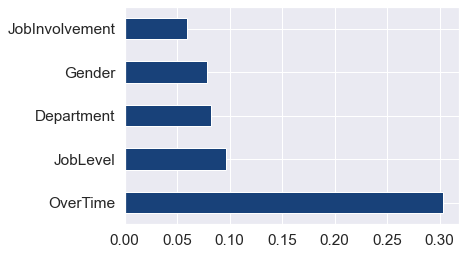

In [127]:
feat_importances = pd.Series(Final_mod.feature_importances_, index=X_scaled.columns)
feat_importances = feat_importances.nlargest()
feat_importances.plot(kind='barh')